<a href="https://colab.research.google.com/github/ashwing97/Airbnb-Estimator/blob/main/Airbnb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project : Airbnb Price Prediction**
#### **Objectives:**
The objective of this proejct is to predict the prices of the Airbnb housing based on various features of the Airbnb properties to help both the hosts and customers of Airbnb financialy. we will use models like Linear Regression, Logistic Regression, Random Forest Classifier and Support Vector Machine method to detect the outlier. The project is divided into following subsections for better insight.
> 
* Part 1: Data Acquisition and Cleaning
* Part 2: Exploratory Analysis
* Part 3: Descriptive Analysis
* Part 4: Predictive Analysis
* Part 5: Prescriptive Analysis

#### **Background:**
The above mentioned models or methods will be implemented on the Airbnb dataset which includes listings and their features from 28 cities across United States. Airbnb is a third party organization/broker that helps people finding homestays and tourism services. The chosen 28 cities are one of the most popular cities in the United States.
>
#### **Resources**: 
* Machine used in the project: (Windows or Mac) Computer with Internet access.
* Python libraries implied: ` pandas, seaborn, geopandas, sklearn, wordcloud, numpy, matplot.lib, datetime, geoplot, statsmodels, missingno, folium`.
* Data Source: The datasets for the cities across the US for Airbnb listings are gathered from the ["Inside Airbnb"](https://data.insideairbnb.com) website. 





### **Part 1:Data Acquisition:**
In part 1, the data will be accumulated from [Inside Airbnb](https://data.insideairbnb.com) for combining, cleaning and further preprocessing to implement the predictive and other important anaylsis. 
>
There were total 28 different datasets about 28 cities' Airbnb listings.
These datasets were combined together to form one large dataset. The combined dataset contains the host_id and other important details for each Airbnb listing that is being used for the analysis in this project. Utilizing this data, we will look at the influence of various features on the prices of the Airbnb listings. 

Several important attributes of the data are mentioned below:
<table style="undefined; table-layout: fixed; width: 953px">
<col group>
<col style= "width: 194.2px">
<col style = "width: 759.2px">
</colgroup>
  <tr>
    <th>Attribute</th>
    <th>Description</th>
  </tr>
  <tr>
    <td>1. property_type </td>
    <td> What kind of property it is?(House, Private room, Shared room, hotel room)</td>
  </tr>
  <tr>
    <td>2. bedrooms</td>
    <td> Represents the number of bedrooms in the property</td>
  </tr>
  <tr>
    <td>3. bathrooms</td>
    <td> Represents the number of bathrooms</td>
  </tr>
  <tr>
    <td>4. amenities</td>
    <td> Additional facilities other than basic</td>
  </tr>
  <tr>
    <td>5. host_id</td>
    <td> Represents a particular host</td>
  </tr>
  <tr>
    <td>6. longitude/ latitude</td>
    <td> Represents the location of the Airbnbs</td>
  </tr>
  <tr>
    <td>7. beds</td>
    <td> Represents the number of beds</td>
  </tr>
  <tr>
    <td>8. price</td>
    <td> Represents the price of the Airbnb property</td>
  </tr>
  <tr>
    <td>9. host_since</td>
    <td> Represents the time since the host has been on the platform.</td>
  </tr>
  <tr>
    <td>10. host_response_time</td>
    <td> Represents the time it takes for the host to response.</td>
  </tr>
  <tr>
    <td>11. host_response_rate</td>
    <td> Represents the rate of hosts responding.</td>
  </tr>
  <tr>
    <td>11. cleaning_fee</td>
    <td> Represents the money needed to pay for cleaning.</td>
  </tr>
</table>


> 

After completing the analysis, below mentioned questions concerning both the hosts and the customers can be answered. 
#### **For Visitor:**
* How much will be the price of a property with certain amenitites included?
* Which area has more Airbnb properties?
* Which property has better reviews?
* What amenities are available?
* What type of properties are mostly used?

#### **For Host:**
* How much to charge for the property?
* What exactly does the visitor expect? 


**Step 1: Importing all the Libraries**




In [ ]:
# Importing all the required libraries
import pandas as pd
from datetime import datetime
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
import seaborn as sns
!pip install geopandas
import geopandas as gpd
!apt-get install libproj-dev proj-data proj-bin
!apt-get install libgeos-dev
!pip install cython
!pip install cartopy
!pip install geoplot
import geoplot as gplt
import geoplot.crs as gcrs
import numpy as np
!pip install wordcloud
from wordcloud import WordCloud, STOPWORDS
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler
%matplotlib inline


Reading package lists... Done
Building dependency tree       
Reading state information... Done
libproj-dev is already the newest version (4.9.3-2).
proj-bin is already the newest version (4.9.3-2).
proj-data is already the newest version (4.9.3-2).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.
Reading package lists... Done
Building dependency tree       
Reading state information... Done
libgeos-dev is already the newest version (3.6.2-1build2).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.


**Step 2: Importing the datasets**


In [ ]:
#Taking data directly from the Airbnb website
%%time
!rm -r data.insideairbnb.com
# Seattle data:
!wget -xq http://data.insideairbnb.com/united-states/wa/seattle/2020-03-17/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/wa/seattle/2020-03-17/data/reviews.csv.gz
# !wget -xq http://data.insideairbnb.com/united-states/wa/seattle/2020-03-17/visualisations/neighbourhoods.geojson
# Boston data:
!wget -xq http://data.insideairbnb.com/united-states/ma/boston/2020-04-14/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ma/boston/2020-04-14/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ma/boston/2020-04-14/visualisations/neighbourhoods.geojson
# Asheville data:
!wget -xq http://data.insideairbnb.com/united-states/nc/asheville/2020-03-21/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/nc/asheville/2020-03-21/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/nc/asheville/2020-03-21/visualisations/neighbourhoods.geojson
# Austin data:
!wget -xq http://data.insideairbnb.com/united-states/tx/austin/2020-03-17/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/tx/austin/2020-03-17/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/tx/austin/2020-03-17/visualisations/neighbourhoods.geojson
#Broward County data:
!wget -xq http://data.insideairbnb.com/united-states/fl/broward-county/2020-03-19/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/fl/broward-county/2020-03-19/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/fl/broward-county/2020-03-19/visualisations/neighbourhoods.geojson

#Cambridge data:
!wget -xq http://data.insideairbnb.com/united-states/ma/cambridge/2020-03-21/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ma/cambridge/2020-03-21/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ma/cambridge/2020-03-21/visualisations/neighbourhoods.geojson

#Chicago data:
!wget -xq http://data.insideairbnb.com/united-states/il/chicago/2020-03-18/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/il/chicago/2020-03-18/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/il/chicago/2020-03-18/visualisations/neighbourhoods.geojson

#Clark County data:
!wget -xq http://data.insideairbnb.com/united-states/nv/clark-county-nv/2020-03-21/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/nv/clark-county-nv/2020-03-21/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/nv/clark-county-nv/2020-03-21/visualisations/neighbourhoods.geojson

#Columbus data:
!wget -xq http://data.insideairbnb.com/united-states/oh/columbus/2020-03-19/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/oh/columbus/2020-03-19/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/oh/columbus/2020-03-19/visualisations/neighbourhoods.geojson

#Denver data:
!wget -xq http://data.insideairbnb.com/united-states/co/denver/2020-03-23/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/co/denver/2020-03-23/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/co/denver/2020-03-23/visualisations/neighbourhoods.geojson

#Hawaii data:
!wget -xq http://data.insideairbnb.com/united-states/hi/hawaii/2020-04-09/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/hi/hawaii/2020-04-09/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/hi/hawaii/2020-04-09/visualisations/neighbourhoods.geojson

#Jersey city data:
!wget -xq http://data.insideairbnb.com/united-states/nj/jersey-city/2020-03-23/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/nj/jersey-city/2020-03-23/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/nj/jersey-city/2020-03-23/visualisations/neighbourhoods.geojson

#los-angeles data:
!wget -xq http://data.insideairbnb.com/united-states/ca/los-angeles/2020-04-14/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/los-angeles/2020-04-14/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/los-angeles/2020-04-14/visualisations/neighbourhoods.geojson

#nashville data:
!wget -xq http://data.insideairbnb.com/united-states/tn/nashville/2020-03-17/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/tn/nashville/2020-03-17/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/tn/nashville/2020-03-17/visualisations/neighbourhoods.geojson

#orleans data:
!wget -xq http://data.insideairbnb.com/united-states/la/new-orleans/2020-04-09/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/la/new-orleans/2020-04-09/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/la/new-orleans/2020-04-09/visualisations/neighbourhoods.geojson

#new-york-city data:
!wget -xq http://data.insideairbnb.com/united-states/ny/new-york-city/2020-04-08/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ny/new-york-city/2020-04-08/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ny/new-york-city/2020-04-08/visualisations/neighbourhoods.geojson

#oakland data:
!wget -xq http://data.insideairbnb.com/united-states/ca/oakland/2020-03-17/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/oakland/2020-03-17/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/oakland/2020-03-17/visualisations/neighbourhoods.geojson

#pacific
!wget -xq http://data.insideairbnb.com/united-states/ca/pacific-grove/2020-03-26/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/pacific-grove/2020-03-26/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/pacific-grove/2020-03-26/visualisations/neighbourhoods.geojson

#portland 
!wget -xq http://data.insideairbnb.com/united-states/or/portland/2020-04-14/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/or/portland/2020-04-14/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/or/portland/2020-04-14/visualisations/neighbourhoods.geojson

#rhode
!wget -xq http://data.insideairbnb.com/united-states/ri/rhode-island/2020-03-26/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ri/rhode-island/2020-03-26/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ri/rhode-island/2020-03-26/visualisations/neighbourhoods.geojson

#salem
!wget -xq http://data.insideairbnb.com/united-states/or/salem-or/2020-03-17/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/or/salem-or/2020-03-17/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/or/salem-or/2020-03-17/visualisations/neighbourhoods.geojson

#sandiego
!wget -xq http://data.insideairbnb.com/united-states/ca/san-diego/2020-03-17/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/san-diego/2020-03-17/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/san-diego/2020-03-17/visualisations/neighbourhoods.geojson

#san-francisco
!wget -xq http://data.insideairbnb.com/united-states/ca/san-francisco/2020-04-07/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/san-francisco/2020-04-07/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/san-francisco/2020-04-07/visualisations/neighbourhoods.geojson

#san-mateo-county
!wget -xq http://data.insideairbnb.com/united-states/ca/san-mateo-county/2019-06-05/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/san-mateo-county/2019-06-05/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/san-mateo-county/2019-06-05/visualisations/neighbourhoods.geojson

#santa-clara
!wget -xq http://data.insideairbnb.com/united-states/ca/santa-clara-county/2020-03-17/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/santa-clara-county/2020-03-17/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/santa-clara-county/2020-03-17/visualisations/neighbourhoods.geojson

#santa-cruz
!wget -xq http://data.insideairbnb.com/united-states/ca/santa-cruz-county/2020-03-26/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/santa-cruz-county/2020-03-26/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/ca/santa-cruz-county/2020-03-26/visualisations/neighbourhoods.geojson

#twin-cities-msa
!wget -xq http://data.insideairbnb.com/united-states/mn/twin-cities-msa/2020-04-14/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/mn/twin-cities-msa/2020-04-14/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/mn/twin-cities-msa/2020-04-14/visualisations/neighbourhoods.geojson

#washington-dc
!wget -xq http://data.insideairbnb.com/united-states/dc/washington-dc/2020-03-18/data/listings.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/dc/washington-dc/2020-03-18/data/reviews.csv.gz
!wget -xq http://data.insideairbnb.com/united-states/dc/washington-dc/2020-03-18/visualisations/neighbourhoods.geojson



!du -sh data.insideairbnb.com

1.2G	data.insideairbnb.com
CPU times: user 1.08 s, sys: 13.6 s, total: 14.6 s
Wall time: 3min 30s


In [ ]:

seattle_path = 'data.insideairbnb.com/united-states/wa/seattle/2020-03-17/'
seattle_listings = pd.read_csv(seattle_path + 'data/listings.csv.gz')

boston_path = 'data.insideairbnb.com/united-states/ma/boston/2020-04-14/'
boston_listings = pd.read_csv(boston_path + 'data/listings.csv.gz')

asheville_path = 'data.insideairbnb.com/united-states/nc/asheville/2020-03-21/'
asheville_listings = pd.read_csv(asheville_path + 'data/listings.csv.gz')

austin_path = 'data.insideairbnb.com/united-states/tx/austin/2020-03-17/'
austin_listings = pd.read_csv(austin_path + 'data/listings.csv.gz')

broward_path = 'data.insideairbnb.com/united-states/fl/broward-county/2020-03-19/'
broward_listings = pd.read_csv(broward_path + 'data/listings.csv.gz')

cambridge_path = 'data.insideairbnb.com/united-states/ma/cambridge/2020-03-21/'
cambridge_listings = pd.read_csv(cambridge_path + 'data/listings.csv.gz')

chicago_path = 'data.insideairbnb.com/united-states/il/chicago/2020-03-18/'
chicago_listings = pd.read_csv(chicago_path + 'data/listings.csv.gz')

clark_path = 'data.insideairbnb.com/united-states/nv/clark-county-nv/2020-03-21/'
clark_listings = pd.read_csv(clark_path + 'data/listings.csv.gz')

columbus_path = 'data.insideairbnb.com/united-states/oh/columbus/2020-03-19/'
columbus_listings = pd.read_csv(columbus_path + 'data/listings.csv.gz')

denver_path = 'data.insideairbnb.com/united-states/co/denver/2020-03-23/'
denver_listings = pd.read_csv(denver_path + 'data/listings.csv.gz')

hawaii_path = 'data.insideairbnb.com/united-states/hi/hawaii/2020-04-09/'
hawaii_listings = pd.read_csv(hawaii_path + 'data/listings.csv.gz')

jersey_path = 'data.insideairbnb.com/united-states/nj/jersey-city/2020-03-23/'
jersey_listings = pd.read_csv(jersey_path + 'data/listings.csv.gz')

la_path = 'data.insideairbnb.com/united-states/ca/los-angeles/2020-04-14/'
la_listings = pd.read_csv(la_path + 'data/listings.csv.gz')

nashville_path = 'data.insideairbnb.com/united-states/tn/nashville/2020-03-17/'
nashville_listings = pd.read_csv(nashville_path + 'data/listings.csv.gz')

orleans_path = 'data.insideairbnb.com/united-states/la/new-orleans/2020-04-09/'
orleans_listings = pd.read_csv(orleans_path + 'data/listings.csv.gz')

ny_path = 'data.insideairbnb.com/united-states/ny/new-york-city/2020-04-08/'
ny_listings = pd.read_csv(ny_path + 'data/listings.csv.gz')

oakland_path = 'data.insideairbnb.com/united-states/ca/oakland/2020-03-17/'
oakland_listings = pd.read_csv(oakland_path + 'data/listings.csv.gz')

pacific_path = 'data.insideairbnb.com/united-states/ca/pacific-grove/2020-03-26/'
pacific_listings = pd.read_csv(pacific_path + 'data/listings.csv.gz')

portland_path = 'data.insideairbnb.com/united-states/or/portland/2020-04-14/'
portland_listings = pd.read_csv(portland_path + 'data/listings.csv.gz')

rhode_path = 'data.insideairbnb.com/united-states/ri/rhode-island/2020-03-26/'
rhode_listings = pd.read_csv(rhode_path + 'data/listings.csv.gz')

salem_path = 'data.insideairbnb.com/united-states/or/salem-or/2020-03-17/'
salem_listings = pd.read_csv(salem_path + 'data/listings.csv.gz')

sandiego_path = 'data.insideairbnb.com/united-states/ca/san-diego/2020-03-17/'
sandiego_listings = pd.read_csv(sandiego_path + 'data/listings.csv.gz')

sanfrancisco_path = 'data.insideairbnb.com/united-states/ca/san-francisco/2020-04-07/'
sanfrancisco_listings = pd.read_csv(sanfrancisco_path + 'data/listings.csv.gz')

sanmateo_path = 'data.insideairbnb.com/united-states/ca/san-mateo-county/2019-06-05/'
sanmateo_listings = pd.read_csv(sanmateo_path + 'data/listings.csv.gz')

santaclara_path = 'data.insideairbnb.com/united-states/ca/santa-clara-county/2020-03-17/'
santaclara_listings = pd.read_csv(santaclara_path + 'data/listings.csv.gz')

santacruz_path = 'data.insideairbnb.com/united-states/ca/santa-cruz-county/2020-03-26/'
santacruz_listings = pd.read_csv(santacruz_path + 'data/listings.csv.gz')

twin_path = 'data.insideairbnb.com/united-states/mn/twin-cities-msa/2020-04-14/'
twin_listings = pd.read_csv(twin_path + 'data/listings.csv.gz')

washington_path = 'data.insideairbnb.com/united-states/dc/washington-dc/2020-03-18/'
washington_listings = pd.read_csv(washington_path + 'data/listings.csv.gz')


/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (61,62) have mixed types.Specify dtype option on import or set low_memory=False.

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (43,61,62) have mixed types.Specify dtype option on import or set low_memory=False.

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (61,62,94,95) have mixed types.Specify dtype option on import or set low_memory=False.

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (43,94) have mixed types.Specify dtype option on import or set low_memory=False.



**Step 3: Create the dataframe** 

In [ ]:
#combining the data from the US cities 
all_listings = pd.concat([seattle_listings, boston_listings, asheville_listings, austin_listings, broward_listings, cambridge_listings, chicago_listings, clark_listings, columbus_listings, denver_listings, hawaii_listings, jersey_listings, la_listings, nashville_listings, orleans_listings, ny_listings, oakland_listings, pacific_listings, portland_listings, rhode_listings, salem_listings, sandiego_listings, sanmateo_listings, santaclara_listings, santacruz_listings, twin_listings, washington_listings],
                        keys = ["seattle", "boston", "asheville", "austin", "broward", "cambridge", "chicago", "clark", "columbus", "denver", "hawaii", "jersey", "la", "nashville", "orleans", "ny", "oakland", "pacific", "portland", "rhode", "salem", "sandiego", "sanfrancisco", "sanmateo", "santaclara", "santacruz", "twin", "washington"])
all_listings.reset_index(level=0, inplace=True)
all_listings.rename(columns={'level_0': 'city_name'}, inplace=True)

In [ ]:
#Printing out the shape of the DataFrame(printing the rows and columns)
all_listings.shape

(245965, 107)

In [ ]:
# print first 5 rows of the dataframe
all_listings.head()

,city_name,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,access,interaction,house_rules,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,...,extra_people,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,seattle,2318,https://www.airbnb.com/rooms/2318,20200317213002,2020-03-17,Casa Madrona - Urban Oasis 1 block from the park!,"Gorgeous, architect remodeled, Dutch Colonial ...","This beautiful, gracious home has been complet...","Gorgeous, architect remodeled, Dutch Colonial ...",none,Madrona is a hidden gem of a neighborhood. It ...,"We adhere to a 10pm -9am quiet hour schedule, ...",NaN,Guests can access any part of the house.,We are a family who live next door and are ava...,NaN,NaN,NaN,https://a0.muscache.com/im/pictures/02973ad3-a...,NaN,2536,https://www.airbnb.com/users/show/2536,Megan,2008-08-26,"Seattle, Washington, United States",I welcome guests from all walks of life and ev...,within an hour,100%,91%,t,https://a0.muscache.com/im/pictures/user/016a1...,https://a0.muscache.com/im/pictures/user/016a1...,Minor,2.0,2.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",t,f,"Seattle, WA, United States",Madrona,...,$25.00,7,1000,7,7,1125,1125,7.0,1125.0,3 weeks ago,t,26,56,86,86,2020-03-17,32,10,2008-09-15,2020-02-01,100.0,10.0,10.0,10.0,10.0,10.0,10.0,t,STR-OPLI-19-002837,"{WASHINGTON,"" Seattle"","" WA""}",t,f,strict_14_with_grace_period,f,f,2,2,0,0,0.23
1,seattle,6606,https://www.airbnb.com/rooms/6606,20200317213002,2020-03-18,"Fab, private seattle urban cottage!","This tiny cottage is only 15x10, but it has ev...","Soo centrally located, this is a little house ...","This tiny cottage is only 15x10, but it has ev...",none,"A peaceful yet highly accessible neighborhood,...","Check in is at three, if you'd like a snack or...",NaN,NaN,I often escape to kingston and my place on the...,Please treat the cottage as if it were your ow...,NaN,NaN,https://a0.muscache.com/im/pictures/45742/2111...,NaN,14942,https://www.airbnb.com/users/show/14942,Joyce,2009-04-26,"Seattle, Washington, United States",I am a therapist/innkeeper.I know my city well...,within a day,90%,94%,f,https://a0.muscache.com/im/users/14942/profile...,https://a0.muscache.com/im/users/14942/profile...,Wallingford,5.0,5.0,"['email', 'phone', 'facebook', 'reviews', 'kba']",t,t,"Seattle, WA, United States",Wallingford,...,$10.00,30,1125,30,30,1125,1125,30.0,1125.0,3 months ago,t,0,16,45,45,2020-03-18,150,15,2009-07-17,2019-09-28,92.0,9.0,9.0,10.0,10.0,10.0,9.0,t,NaN,"{WASHINGTON,"" Seattle"","" WA""}",f,f,strict_14_with_grace_period,f,f,3,3,0,0,1.15
2,seattle,9419,https://www.airbnb.com/rooms/9419,20200317213002,2020-03-18,Glorious sun room w/ memory foambed,This beautiful double room features a magical ...,Our new Sunny space has a private room from th...,This be

**Step 4: Data cleaning and pre-processing**

In [ ]:
#printing the data types for all the columns in the listings
all_listings.dtypes

city_name                                        object
id                                                int64
listing_url                                      object
scrape_id                                         int64
last_scraped                                     object
name                                             object
summary                                          object
space                                            object
description                                      object
experiences_offered                              object
neighborhood_overview                            object
notes                                            object
transit                                          object
access                                           object
interaction                                      object
house_rules                                      object
thumbnail_url                                   float64
medium_url                                      

In [ ]:
all_listings.duplicated().sum()

0

In [ ]:
#printing the headings of all the columns in the listing data
all_listings.columns

Index(['city_name', 'id', 'listing_url', 'scrape_id', 'last_scraped', 'name',
       'summary', 'space', 'description', 'experiences_offered',
       ...
       'instant_bookable', 'is_business_travel_ready', 'cancellation_policy',
       'require_guest_profile_picture', 'require_guest_phone_verification',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'reviews_per_month'],
      dtype='object', length=107)

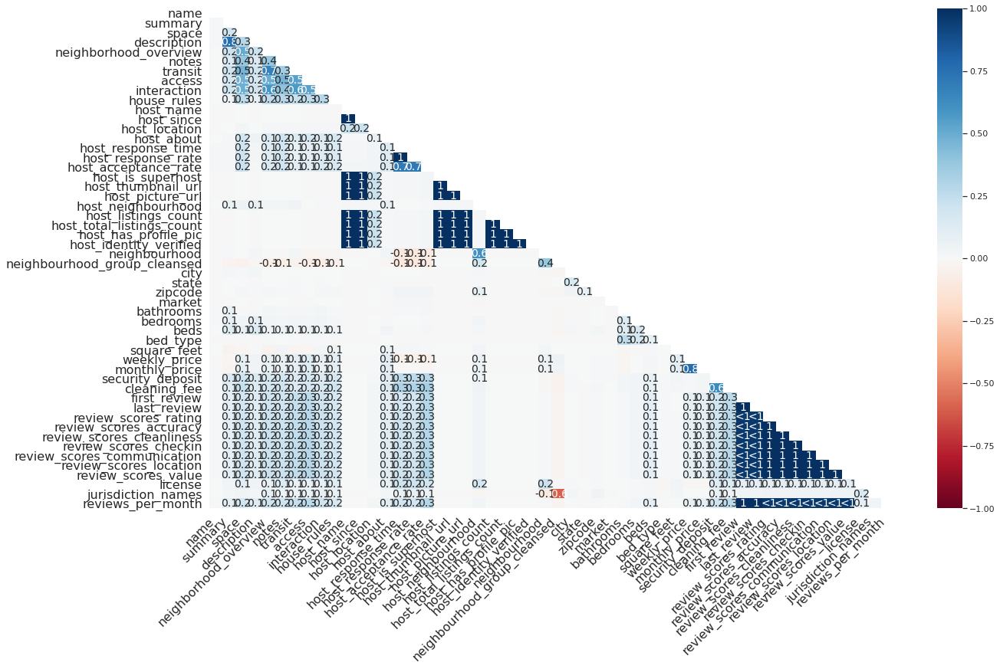

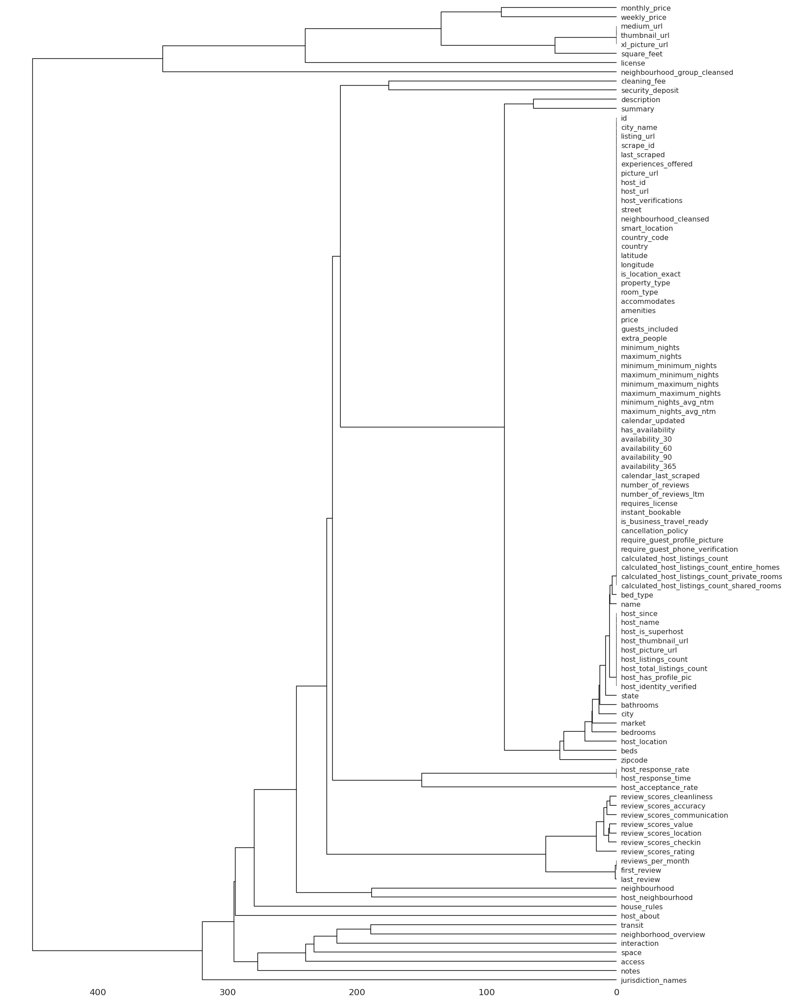

In [ ]:
#visualizing the missing data

import missingno as msno 
%matplotlib inline  
# Visualize missing values as a heatmap
msno.heatmap(all_listings) 
# Nullity correlation ranges from -1(totally opposite) to 0(no effect on each other) to 1 (affect each other).
# Variables which are not correlated, are removed from the visualization
# for instance, the datetime and injury number columns are not included.
# Entries marked <1 or >-1 are have a correlation that is close to being exactingly negative or positive, but is still not quite perfectly so. 
# This points to a small number of records in the dataset which are erroneous
msno.dendrogram(all_listings)

In [ ]:
#missing data
pd.set_option('display.max_rows', 120)

#We can remove the columns that does not have any values.
all_listings.isna().sum()



city_name                                            0
id                                                   0
listing_url                                          0
scrape_id                                            0
last_scraped                                         0
name                                                27
summary                                           9591
space                                            55383
description                                       5496
experiences_offered                                  0
neighborhood_overview                            79047
notes                                           120168
transit                                          89187
access                                          102410
interaction                                      85850
house_rules                                      77164
thumbnail_url                                   245965
medium_url                                      245965
picture_ur

In [ ]:
# drop all columns that has majority null values

cols_to_drop = ['listing_url','host_url','host_picture_url','picture_url','host_thumbnail_url','thumbnail_url','medium_url','xl_picture_url','monthly_price','weekly_price','license','neighbourhood_group_cleansed',
                'notes','access','jurisdiction_names','transit','interaction','host_about','neighborhood_overview','house_rules','host_neighbourhood',
              'space']

filtered_listings = all_listings.drop(cols_to_drop, axis=1)

In [ ]:
#printing the head of the listing dataset 
filtered_listings.head()

,city_name,id,scrape_id,last_scraped,name,summary,description,experiences_offered,host_id,host_name,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,...,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,seattle,2318,20200317213002,2020-03-17,Casa Madrona - Urban Oasis 1 block from the park!,"Gorgeous, architect remodeled, Dutch Colonial ...","Gorgeous, architect remodeled, Dutch Colonial ...",none,2536,Megan,2008-08-26,"Seattle, Washington, United States",within an hour,100%,91%,t,2.0,2.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",t,f,"Seattle, WA, United States",Madrona,Madrona,Seattle,WA,98122,Seattle,"Seattle, WA",US,United States,47.61082,-122.29082,t,House,Entire home/apt,9,2.5,4.0,4.0,...,$250.00,8,$25.00,7,1000,7,7,1125,1125,7.0,1125.0,3 weeks ago,t,26,56,86,86,2020-03-17,32,10,2008-09-15,2020-02-01,100.0,10.0,10.0,10.0,10.0,10.0,10.0,t,t,f,strict_14_with_grace_period,f,f,2,2,0,0,0.23
1,seattle,6606,20200317213002,2020-03-18,"Fab, private seattle urban cottage!","This tiny cottage is only 15x10, but it has ev...","This tiny cottage is only 15x10, but it has ev...",none,14942,Joyce,2009-04-26,"Seattle, Washington, United States",within a day,90%,94%,f,5.0,5.0,"['email', 'phone', 'facebook', 'reviews', 'kba']",t,t,"Seattle, WA, United States",Wallingford,Wallingford,Seattle,WA,98103,Seattle,"Seattle, WA",US,United States,47.65411,-122.33761,t,Guesthouse,Entire home/apt,2,1.0,1.0,1.0,...,$40.00,2,$10.00,30,1125,30,30,1125,1125,30.0,1125.0,3 months ago,t,0,16,45,45,2020-03-18,150,15,2009-07-17,2019-09-28,92.0,9.0,9.0,10.0,10.0,10.0,9.0,t,f,f,strict_14_with_grace_period,f,f,3,3,0,0,1.15
2,seattle,9419,20200317213002,2020-03-18,Glorious sun room w/ memory foambed,This beautiful double room features a magical ...,This beautiful double room features a magical ...,none,30559,Angielena,2009-08-09,"Seattle, Washington, United States",within a few hours,96%,92%,t,8.0,8.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",t,t,"Seattle, WA, United States",Georgetown,Georgetown,Seattle,WA,98108,Seattle,"Seattle, WA",US,United States,47.55017,-122.31937,t,Apartment,Private room,2,3.0,1.0,1.0,...,$20.00,1,$15.00,2,180,2,2,180,180,2.0,180.0,2 weeks ago,t,30,60,90,365,2020-03-18,148,16,2010-07-30,2019-12-27,93.0,10.0,10.0,10.0,10.0,10.0,10.0,t,f,f,moderate,t,t,8,0,8,0,1.26
3,seattle,9460,20200317213002,2020-03-18,Downtown Convention Center B&B -- Free Minibar,Take up a glass of wine and unwind on one of t...,Take up a glass of wine and unwind on one of t...,none,30832,Siena,2009-08-10,"Seattle, Washington, United States",within an hour,100%,100%,t,4.0,4.0,"['email', 'phone', 'reviews', 'offline_governm...",t,f,"Seattle, WA, United States",First Hill,First Hill,Seattle,WA,98101,Seattle,"Seattle, WA",US,United States,47.61265,-122.32936,t,Condominium,Pr

*Some of the columns like minimum and maximum night stays are duplicated with some additional features in one of them, so we only choose two of them which refers to the minimum & maximum default nights.*

In [ ]:
sum((filtered_listings.minimum_nights == filtered_listings.minimum_minimum_nights) == False)

18199

In [ ]:
#dropping out some of the columns which are not required for the project
filtered_listings.drop(['minimum_minimum_nights', 'maximum_minimum_nights', 'minimum_maximum_nights', 'maximum_maximum_nights', 'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm'], axis=1, inplace=True)

*Having a look at the attributes which are booleans and see how they can be used for the analysis.*

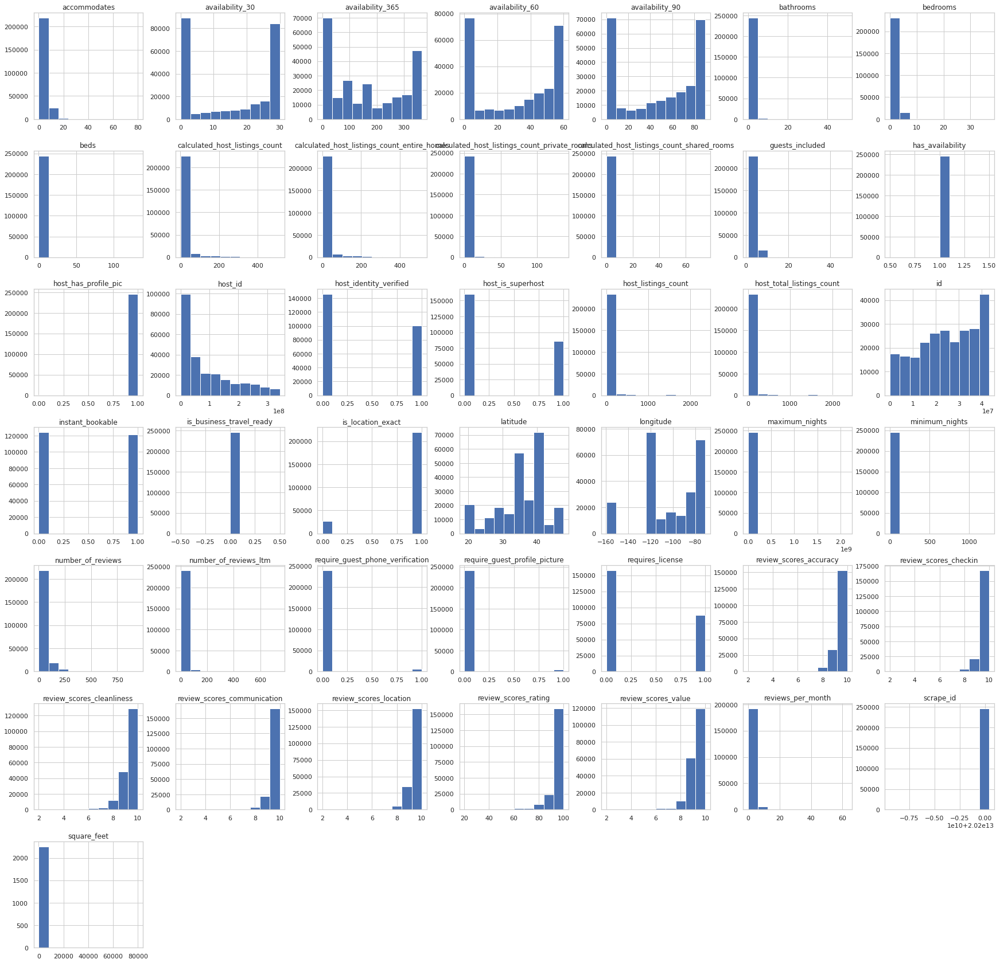

In [ ]:
# Replacing columns with f/t with 0/1
filtered_listings.replace({'f': 0, 't': 1}, inplace=True)

# Plotting the distribution of numerical and boolean categories
filtered_listings.hist(figsize=(30,30));

*Many columns can be dropped as they are not used for the analysis.*

In [ ]:
#Columns which are not that useful can be dropped 
filtered_listings.drop(['has_availability', 'host_has_profile_pic', 'is_business_travel_ready', 'maximum_nights', 'minimum_nights', 'require_guest_phone_verification', 'require_guest_profile_picture', 'requires_license', 'scrape_id'], axis=1, inplace=True)

In [ ]:
#putting the columns of the listings into the list 
filtered_listings.columns.tolist()

['city_name',
 'id',
 'last_scraped',
 'name',
 'summary',
 'description',
 'experiences_offered',
 'host_id',
 'host_name',
 'host_since',
 'host_location',
 'host_response_time',
 'host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_listings_count',
 'host_total_listings_count',
 'host_verifications',
 'host_identity_verified',
 'street',
 'neighbourhood',
 'neighbourhood_cleansed',
 'city',
 'state',
 'zipcode',
 'market',
 'smart_location',
 'country_code',
 'country',
 'latitude',
 'longitude',
 'is_location_exact',
 'property_type',
 'room_type',
 'accommodates',
 'bathrooms',
 'bedrooms',
 'beds',
 'bed_type',
 'amenities',
 'square_feet',
 'price',
 'security_deposit',
 'cleaning_fee',
 'guests_included',
 'extra_people',
 'calendar_updated',
 'availability_30',
 'availability_60',
 'availability_90',
 'availability_365',
 'calendar_last_scraped',
 'number_of_reviews',
 'number_of_reviews_ltm',
 'first_review',
 'last_review',
 'review_scores_rating',
 'r

*Looking and cleaning each column to see it is important for the dataset.* 

**experiences_offered**

*Most of the experiences_offered column is empty so we consider on dropping it.*

In [ ]:
filtered_listings.experiences_offered.value_counts()

none    245965
Name: experiences_offered, dtype: int64

In [ ]:
filtered_listings.drop('experiences_offered', axis=1, inplace=True)

**host_since**
>
*host_since column represents the time, since the host has been on the platform. It is a datetime column, which can be used to calculate the number of days and then graph the difference between various hosts with their starting date.* 

In [ ]:
filtered_listings.host_since = pd.to_datetime(filtered_listings.host_since) 

# Calculating the number of days
filtered_listings['host_days_active'] = (datetime(2019, 4, 9) - filtered_listings.host_since).astype('timedelta64[D]')

# Printing mean and median
print("Mean days as host:", round(filtered_listings['host_days_active'].mean(),0))
print("Median days as host:", filtered_listings['host_days_active'].median())

# Replacing null values with the median
filtered_listings.host_days_active.fillna(filtered_listings.host_days_active.median(), inplace=True)

Mean days as host: 1228.0
Median days as host: 1208.0


**host_response_time**

*host_response_time has so many unknown rows in the listings, it can be categorized as 'unknown'.*

In [ ]:
print("Null values:", filtered_listings.host_response_time.isna().sum())
print(f"Proportion: {round((filtered_listings.host_response_time.isna().sum()/len(filtered_listings))*100, 1)}%")

# Rows with no host_response_time and no reviews yet 
len(filtered_listings[filtered_listings.loc[ :,['host_response_time', 'first_review'] ].isnull().sum(axis=1) == 2])

Null values: 53887
Proportion: 21.9%


17807

In [ ]:
filtered_listings.host_response_time.fillna("unknown", inplace=True)
filtered_listings.host_response_time.value_counts(normalize=True)

within an hour        0.577745
unknown               0.219084
within a few hours    0.120619
within a day          0.067619
a few days or more    0.014933
Name: host_response_time, dtype: float64

**host_response_rate**

*host_response_rate has 1/3rd of the values as empty. After putting the values into meaningful groups, host_response_rate can be categorized as separate (i.e. transforming this into a categorical feature, rather than a numerical one).*

In [ ]:
print("Null values:", filtered_listings.host_response_rate.isna().sum())
print(f"Proportion: {round((filtered_listings.host_response_rate.isna().sum()/len(filtered_listings))*100, 1)}%")

Null values: 53887
Proportion: 21.9%


In [ ]:
# removing % sign and convert the host_response_rate into integer values
filtered_listings.host_response_rate = filtered_listings.host_response_rate.str[:-1].astype('float64')

print("Mean host response rate:", round(filtered_listings['host_response_rate'].mean(),0))
print("Median host response rate:", filtered_listings['host_response_rate'].median())
print(f"Proportion of 100% host response rates: {round(((filtered_listings.host_response_rate == 100.0).sum()/filtered_listings.host_response_rate.count())*100,1)}%")

Mean host response rate: 95.0
Median host response rate: 100.0
Proportion of 100% host response rates: 74.2%


In [ ]:
# Categorizing into 4 different categories
filtered_listings.host_response_rate = pd.cut(filtered_listings.host_response_rate, bins=[0, 50, 90, 99, 100], labels=['0-49%', '50-89%', '90-99%', '100%'], include_lowest=True)

# Converting to string
filtered_listings.host_response_rate = filtered_listings.host_response_rate.astype('str')

# Replacing empty values with 'unknown'
filtered_listings.host_response_rate.replace('nan', 'unknown', inplace=True)

# Category counts
filtered_listings.host_response_rate.value_counts()

100%       142529
unknown     53887
50-89%      22578
90-99%      21733
0-49%        5238
Name: host_response_rate, dtype: int64

**host_is_superhost**

*There are no rows which lack the values for each of four distinctive host-related features.*

In [ ]:
# Number of rows without a value for multiple host-related columns
len(filtered_listings[filtered_listings.loc[ :,['host_since', 'host_is_superhost', 'host_listings_count', 'host_identity_verified'] ].isnull().sum(axis=1) == 5])

0

**property_type**

*The property types needs to be cleaned as there are number of them. So we can put them into smaller number of categories like 'house', 'apartment' and 'others', because most of the property_type can be put together as either apartments or houses.*

In [ ]:
#Counting the number of property_types individually
filtered_listings.property_type.value_counts()

Apartment                 94898
House                     69392
Condominium               30105
Townhouse                 10621
Guest suite                9240
Guesthouse                 6025
Serviced apartment         4502
Loft                       3775
Bungalow                   3073
Villa                      2360
Boutique hotel             1850
Cottage                    1801
Resort                     1419
Hotel                      1243
Bed and breakfast          1174
Other                       710
Camper/RV                   644
Hostel                      558
Cabin                       489
Tiny house                  476
Aparthotel                  474
Farm stay                   240
Boat                        170
Tent                         92
Treehouse                    62
Campsite                     60
Dome house                   60
Earth house                  57
Yurt                         54
Castle                       51
Chalet                       46
Houseboa

In [ ]:
# Replacing categories that are types of houses or apartments
filtered_listings.property_type.replace({
    'Townhouse': 'House',
    'Serviced apartment': 'Apartment',
    'Loft': 'Apartment',
    'Bungalow': 'House',
    'Cottage': 'House',
    'Villa': 'House',
    'Tiny house': 'House',
    'Earth house': 'House',
    'Chalet': 'House'  
    }, inplace=True)

# Replacing other categories with 'other'
filtered_listings.loc[~filtered_listings.property_type.isin(['House', 'Apartment']), 'property_type'] = 'Other'

**bathrooms, bedrooms and beds**

*These columns contain a large number of missing values, so we will replace those missing values with the median.*

In [ ]:
#filling the missing values of bedrooms & bathrooms with a median
for col in ['bathrooms', 'bedrooms']:
    filtered_listings[col].fillna(filtered_listings[col].median(), inplace=True)

**bed_type**

*Listings for the most part contains one type of bed which is 'Real Bed', so we can drop this column.*

In [ ]:
#Counting the number of bed_types individually
filtered_listings.bed_type.value_counts()

Real Bed         243914
Futon               791
Pull-out Sofa       583
Airbed              453
Couch               213
Name: bed_type, dtype: int64

In [ ]:
#dropping the bed_type column from the listings as most of the bed_types are Real Bed
filtered_listings.drop('bed_type', axis=1, inplace=True)

**amenities**

*amenities represents the things which are additional other than just the basic features. Some of the examples of the amenities are given below:*

In [ ]:
# Example of amenities listed
filtered_listings.amenities[:1].values

array(['{Internet,Wifi,Kitchen,"Free parking on premises","Pets allowed","Free street parking","Indoor fireplace",Heating,"Family/kid friendly",Washer,Dryer,"Smoke detector","Carbon monoxide detector","First aid kit","Fire extinguisher",Essentials,Shampoo,Hangers,"Hair dryer",Iron,"Laptop friendly workspace","High chair","Children’s books and toys","Pack ’n Play/travel crib","Hot water",Microwave,"Coffee maker",Refrigerator,Dishwasher,"Dishes and silverware","Cooking basics",Oven,Stove,"Patio or balcony","Garden or backyard","Luggage dropoff allowed","Long term stays allowed","Host greets you","Lake access"}'],
      dtype=object)

In [ ]:
amenities_list = list(filtered_listings.amenities)   #creating a list of amenities from the amenities column from the listing data
amenities_list_string = " ".join(amenities_list)  #joining the list to convert into a string
amenities_list_string = amenities_list_string.replace('{', '')    #replace the extra symbols with exmpty space 
amenities_list_string = amenities_list_string.replace('}', ',')     #to make the amenities cleaner
amenities_list_string = amenities_list_string.replace('"', '')
amenities_set = [x.strip() for x in amenities_list_string.split(',')]
amenities_set = set(amenities_set)                     
amenities_set

{'',
 '24-hour check-in',
 'Accessible-height bed',
 'Accessible-height toilet',
 'Air conditioning',
 'Air hockey table',
 'Air purifier',
 'Alarm system',
 'Alfresco bathtub',
 'Alfresco shower',
 'Amazon Echo',
 'Apple TV',
 'Art studio',
 'Arts and Crafts',
 'BBQ grill',
 'Baby bath',
 'Baby equipment',
 'Baby monitor',
 'Babysitter recommendations',
 'Baking sheet',
 'Balcony',
 'Bar',
 'Barbecue utensils',
 'Basketball court',
 'Bath towel',
 'Bathrobe',
 'Bathrobes',
 'Bathroom essentials',
 'Bathtub',
 'Bathtub with bath chair',
 'Beach',
 'Beach bar',
 'Beach chairs',
 'Beach club',
 'Beach essentials',
 'Beach towels',
 'Beach umbrella',
 'Beach view',
 'Beach volleyball',
 'Beachfront',
 'Bed linens',
 'Bedroom comforts',
 'Bicycle',
 'Bidet',
 'Bike storage',
 'Bikes for rent',
 'Blender',
 'Bluetooth speaker',
 'Board games',
 'Boat',
 'Bocce ball court',
 'Body soap',
 'Boogie boards',
 'Booster seat',
 'Bose stereo',
 'Bottled water',
 'Bread maker',
 'Breakfast',
 'Brea

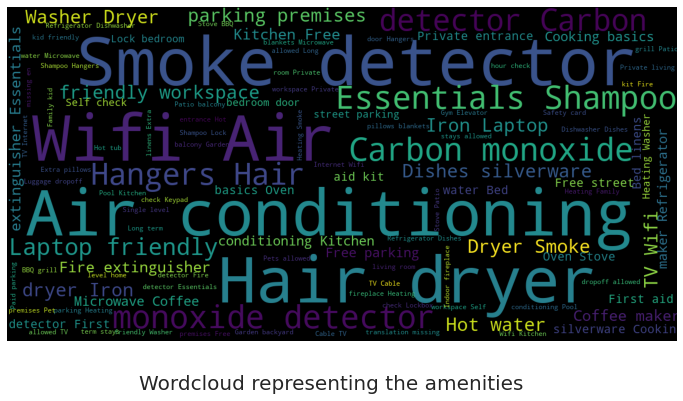

In [ ]:
#creating the wordcloud using the common words which occured in amenities
from wordcloud import WordCloud, STOPWORDS

comment_words = ''
stopwords = set(STOPWORDS)

def show_wordcloud(data, title = 'Wordcloud representing the amenities'): #defining the wordcloud and giving a title
    wordcloud = WordCloud(
        background_color='black',   #defining the background color of the wordcloud
        stopwords=stopwords,      
        max_words=200,            #maximum number of words in the wordcloud
        max_font_size=40,         #maximum size for the word
        scale=3,
        random_state=1 
    ).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))     #figure size 
    plt.axis('off')                          #not plotting the graph axis
    if title: 
        fig.suptitle(title, fontsize=20) 
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

show_wordcloud(amenities_list)

In [ ]:
filtered_listings.loc[filtered_listings['amenities'].str.contains('Air conditioning|Central air conditioning'), 'air_conditioning'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Amazon Echo|Apple TV|Game console|Netflix|Projector and screen|Smart TV'), 'high_end_electronics'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('BBQ grill|Fire pit|Propane barbeque'), 'bbq'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Balcony|Patio'), 'balcony'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Beach view|Beachfront|Lake access|Mountain view|Ski-in/Ski-out|Waterfront'), 'nature_and_views'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Bed linens'), 'bed_linen'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Breakfast'), 'breakfast'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('TV'), 'tv'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Coffee maker|Espresso machine'), 'coffee_machine'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Cooking basics'), 'cooking_basics'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Dishwasher|Dryer|Washer'), 'white_goods'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Elevator'), 'elevator'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Exercise equipment|Gym|gym'), 'gym'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Family/kid friendly|Children|children'), 'child_friendly'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('parking'), 'parking'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Garden|Outdoor|Sun loungers|Terrace'), 'outdoor_space'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Host greets you'), 'host_greeting'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Hot tub|Jetted tub|hot tub|Sauna|Pool|pool'), 'hot_tub_sauna_or_pool'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Internet|Pocket wifi|Wifi'), 'internet'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Long term stays allowed'), 'long_term_stays'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Pets|pet|Cat(s)|Dog(s)'), 'pets_allowed'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Private entrance'), 'private_entrance'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Safe|Security system'), 'secure'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Self check-in'), 'self_check_in'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Smoking allowed'), 'smoking_allowed'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Step-free access|Wheelchair|Accessible'), 'accessible'] = 1
filtered_listings.loc[filtered_listings['amenities'].str.contains('Suitable for events'), 'event_suitable'] = 1

/usr/local/lib/python3.6/dist-packages/pandas/core/strings.py:1954: UserWarning:

This pattern has match groups. To actually get the groups, use str.extract.



In [ ]:
filtered_listings.columns[40:]

Index(['security_deposit', 'cleaning_fee', 'guests_included', 'extra_people',
       'calendar_updated', 'availability_30', 'availability_60',
       'availability_90', 'availability_365', 'calendar_last_scraped',
       'number_of_reviews', 'number_of_reviews_ltm', 'first_review',
       'last_review', 'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value', 'instant_bookable', 'cancellation_policy',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'reviews_per_month',
       'host_days_active', 'air_conditioning', 'high_end_electronics', 'bbq',
       'balcony', 'nature_and_views', 'bed_linen', 'breakfast', 'tv',
       'coffee_machine', 'cooking_basics', 'white_goods', 'elevator', 'gym

**price**

*Converting the price into an integer type which is initially a string as it has currency sign in front of it.*

In [ ]:
filtered_listings.price = filtered_listings.price.str[1:-3]
filtered_listings.price = filtered_listings.price.str.replace(",", "")    #removing the ',' from the price strings 
filtered_listings.price = filtered_listings.price.str.replace("$", "")    #removing the '$' from the beginning of price strings
filtered_listings.price = pd.to_numeric(filtered_listings.price, errors= 'coerce')

**cleaning_fee**

*cleaning_fee which is a string initially can be converted into an integer. Some of the rows for cleaning_fee have empty values in them, which also means there is no cleaning fee, so we replace the empty values with 0.*

In [ ]:
filtered_listings.cleaning_fee.isna().sum()

33191

In [ ]:
filtered_listings.cleaning_fee = filtered_listings.cleaning_fee.str[1:-3]
filtered_listings.cleaning_fee = filtered_listings.cleaning_fee.str.replace(",", "")
filtered_listings.cleaning_fee.fillna(0, inplace=True)
filtered_listings.cleaning_fee = filtered_listings.cleaning_fee.astype('int64')

**extra_people**

*extra_people is also a string initially, so we convert it into interger values. Some of the extra_people values are empty which also means no extra_people so we replace the empty values with 0.*

In [ ]:
filtered_listings.extra_people = filtered_listings.extra_people.str[1:-3]
filtered_listings.extra_people = filtered_listings.extra_people.str.replace(",", "")
filtered_listings.extra_people.fillna(0, inplace=True)
filtered_listings.extra_people = filtered_listings.extra_people.astype('int64')

**calendar_updated**

*The calendar_updated feature links various features on how those features vary throughout the year. This feature is not used in our project so we can drop it.*

In [ ]:
print("Number of categories:", filtered_listings.calendar_updated.nunique())
print("\nTop five categories:")
filtered_listings.calendar_updated.value_counts()[:5]

Number of categories: 105

Top five categories:


today           33942
2 months ago    17878
2 weeks ago     15884
4 weeks ago     14561
a week ago      13449
Name: calendar_updated, dtype: int64

In [ ]:
filtered_listings.drop('calendar_updated', axis=1, inplace=True)

**availability**

*The dataset has many availablity columns which are correlated with each other, so we choose the ones which are highly related and useful for our project.*

In [ ]:
filtered_listings.drop(['availability_30', 'availability_60'], axis=1, inplace=True)

**first_review and last_review**

*These categories can be categorized as ‘unknown’ as a large part of the reviews are empty, but these cannot be removed as they are really important for the project. Replacing the empty values with mean & median values, will not be helpful as the information will be skewed differently.*

In [ ]:
print(f"Null values in 'first_review': {round(100*filtered_listings.first_review.isna().sum()/len(filtered_listings),1)}%")
print(f"Null values in 'review_scores_rating': {round(100*filtered_listings.review_scores_rating .isna().sum()/len(filtered_listings),1)}%")

Null values in 'first_review': 19.2%
Null values in 'review_scores_rating': 20.3%


In [ ]:
filtered_listings.first_review = pd.to_datetime(filtered_listings.first_review) # Converting to datetime

# Calculating the number of days between the first review and the date the data was scraped
filtered_listings['time_since_first_review'] = (datetime(2019, 4, 9) - filtered_listings.first_review).astype('timedelta64[D]')

Text(0, 0.5, '......')

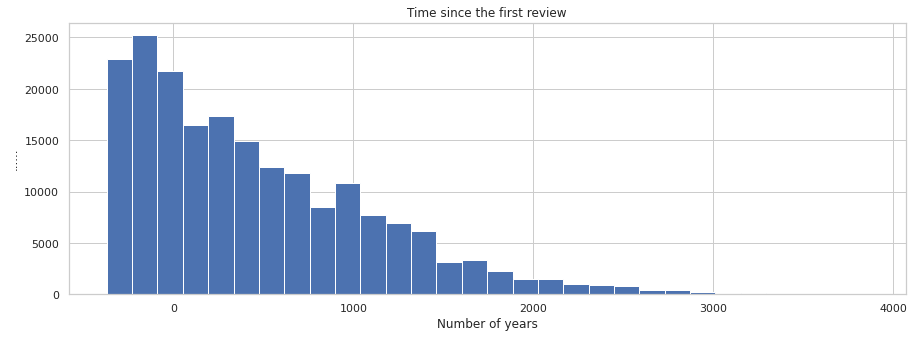

In [ ]:
# Distribution of the number of days since first review
filtered_listings.time_since_first_review.hist(figsize=(15,5), bins=30);
plt.title('Time since the first review')
plt.xlabel('Number of years')
plt.ylabel('......')

In [ ]:
def bin_column(col, bins, labels, na_label='unknown'):
    """
    Takes in a column name, bin cut points and labels, replaces the original column with a
    binned version, and replaces nulls (with 'unknown' if unspecified).
    """
    filtered_listings[col] = pd.cut(filtered_listings[col], bins=bins, labels=labels, include_lowest=True)
    filtered_listings[col] = filtered_listings[col].astype('str')
    filtered_listings[col].fillna(na_label, inplace=True)

In [ ]:
# Binning time since first review
bin_column('time_since_first_review',
           bins=[0, 182, 365, 730, 1460, max(filtered_listings.time_since_first_review)],
           labels=['0-6 months',
                   '6-12 months',
                   '1-2 years',
                   '2-3 years',
                   '4+ years'],
           na_label='no reviews')

Text(0.5, 1.0, 'time between the last comment and the data scrapping date')

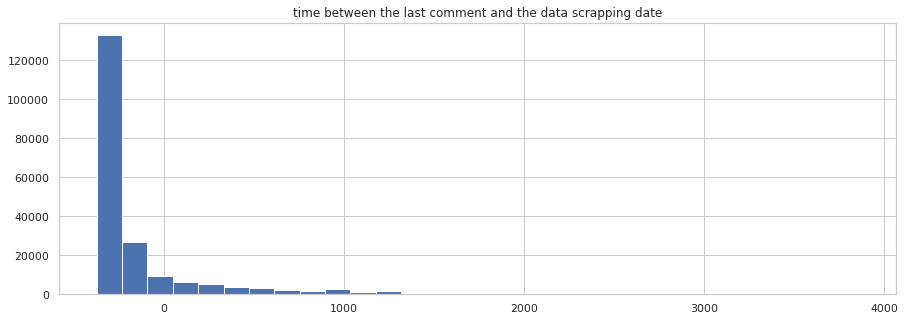

In [ ]:
filtered_listings.last_review = pd.to_datetime(filtered_listings.last_review) # Converting to datetime

# Calculating the number of days between the most recent review and the date the data was scraped
filtered_listings['time_since_last_review'] = (datetime(2019, 4, 9) - filtered_listings.last_review).astype('timedelta64[D]')


# Distribution of the number of days since last review
filtered_listings.time_since_last_review.hist(figsize=(15,5), bins=30);
plt.title('time between the last comment and the data scrapping date')

In [ ]:
# Binning time since last review
bin_column('time_since_last_review',
           bins=[0, 14, 60, 182, 365, max(filtered_listings.time_since_last_review)],
           labels=['0-2 weeks',
                   '2-8 weeks',
                   '2-6 months',
                   '6-12 months',
                   '1+ year'],
           na_label='no reviews')

**review ratings columns**

*The review ratings columns mostly has 9 or 10 which can be put together in one bin and rest of the review from 1 to 8 can be put in a separate bin. This can also be seen in the bar graph.* 

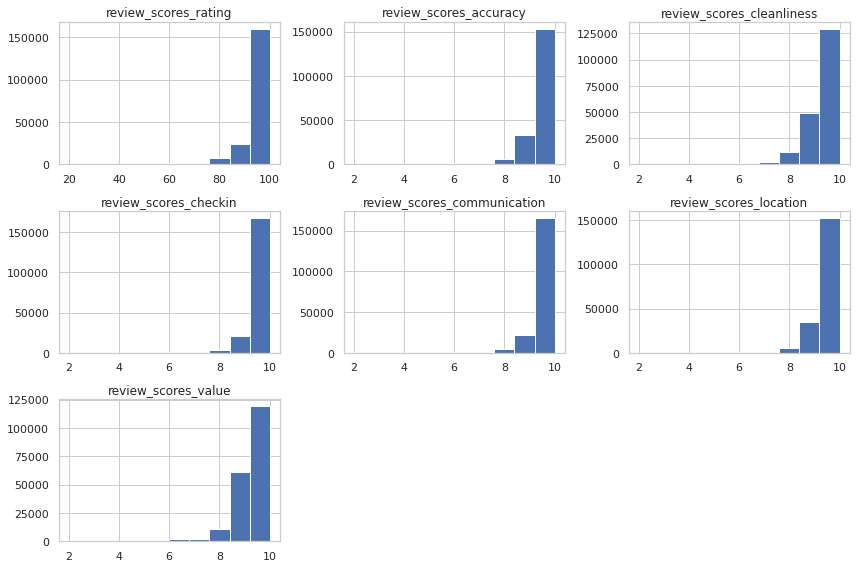

In [ ]:
# Checking the distributions of the review ratings columns
variables_to_plot = list(filtered_listings.columns[filtered_listings.columns.str.startswith("review_scores") == True])
fig = plt.figure(figsize=(12,8))
for i, var_name in enumerate(variables_to_plot):
    ax = fig.add_subplot(3,3,i+1)
    filtered_listings[var_name].hist(bins=10,ax=ax)
    ax.set_title(var_name)
fig.tight_layout()
plt.show()

In [ ]:
# Creating a list of all review columns that are scored out of 10
variables_to_plot.pop(0)

'review_scores_rating'

In [ ]:
# Binning for all columns scored out of 10
for col in variables_to_plot:
    bin_column(col,
               bins=[0, 8, 9, 10],
               labels=['0-8/10', '9/10', '10/10'],
               na_label='no reviews')

In [ ]:
bin_column('review_scores_rating',
           bins=[0, 80, 95, 100],
           labels=['0-79/100', '80-94/100', '95-100/100'],
           na_label='no reviews')

In [ ]:
filtered_listings.describe()

,id,host_id,host_is_superhost,host_listings_count,host_total_listings_count,host_identity_verified,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,beds,square_feet,price,cleaning_fee,guests_included,extra_people,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_days_active,air_conditioning,high_end_electronics,bbq,balcony,nature_and_views,bed_linen,breakfast,tv,coffee_machine,cooking_basics,white_goods,elevator,gym,child_friendly,parking,outdoor_space,host_greeting,hot_tub_sauna_or_pool,internet,long_term_stays,pets_allowed,private_entrance,secure,self_check_in,smoking_allowed,accessible,event_suitable
count,2.459650e+05,2.459650e+05,245935.000000,245935.000000,245935.000000,245935.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,244338.000000,2255.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,198692.000000,245965.000000,197364.0,5487.0,41774.0,76911.0,13165.0,113028.0,23795.0,203349.0,137009.0,119771.0,183902.0,51016.0,40614.0,82945.0,188718.0,60282.0,22944.0,61553.0,240366.0,76493.0,49837.0,104883.0,27921.0,94514.0,9959.0,8174.0,13264.0
mean,2.479613e+07,9.042310e+07,0.348185,63.341692,63.341692,0.407555,35.701227,-102.227451,0.892383,4.025744,1.430024,1.534450,2.159337,885.637694,244.185299,84.628386,2.044482,12.877023,47.787254,160.388035,34.950871,13.221609,0.495009,17.157567,15.098124,1.329722,0.274539,1.757745,1228.175525,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
std,1.245470e+07,9.264392e+07,0.476396,280.262610,280.262610,0.491381,6.830418,26.027151,0.309897,2.816358,0.845655,1.148808,1.869326,1814.615816,713.266120,98.841047,1.979373,24.573993,35.850255,135.565737,62.276705,20.474240,0.499976,49.156410,48.169276,5.413297,2.873792,1.924146,852.384480,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,1.090000e+02,2.300000e+01,0.000000,0.000000,0.000000,0.000000,18.920990,-159.714900,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.010000,-370.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
25%,1.525712e+07,1.418729e+07,0.000000,1.000000,1.000000,0.000000,32.764360,-118.389260,1.000000,2.000000,1.000000,1.000000,1.000000,490.000000,75.000000,20.000000,1.000000,0.000000,0.000000,12.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.330000,599.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
50%,2.520968e+07,5.137009e+07,0.000000,2.000000,2.000000,0.000000,36.173860,-97.743930,1.000000,4.000000,1.000000,1.000000,2.000000,700.000000,125.000000,60.000000,1.000000,0.000000,57.000000,146.000000,9.000000,4.000000,0.000000,2.000000,1.000000,0.000000,0.000000,1.060000,1208.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
75%,3.600334e+07,1.463899e+08,1.000000,8.000000,8.000000,1.000000,40.728250,-74.071650,1.000000,5.000000,2.000000,2.000000,3.000000,1000.000000,215.000000,115.000000,2.000000,20.000000,83.000000,298.000000,41.000000,19.000000,1.000000,7.000000,4.000000,1.000000,0.000000,2.610000,1819.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
max,4.318061e+07,3.437903e+08,1.000000,2354.000000,2354.000000,1.000000,47.734030,-70.995950,1.000000,80.000000,50.000000,37.000000

In [ ]:
filtered_listings.property_type.value_counts()

Apartment    103175
House         87826
Other         54964
Name: property_type, dtype: int64

In [ ]:
filtered_listings['city_name'].unique()

array(['seattle', 'boston', 'asheville', 'austin', 'broward', 'cambridge',
       'chicago', 'clark', 'columbus', 'denver', 'hawaii', 'jersey', 'la',
       'nashville', 'orleans', 'ny', 'oakland', 'pacific', 'portland',
       'rhode', 'salem', 'sandiego', 'sanfrancisco', 'sanmateo',
       'santaclara', 'santacruz', 'twin'], dtype=object)

Text(0.5, 1.0, 'Neighbourhood Group')

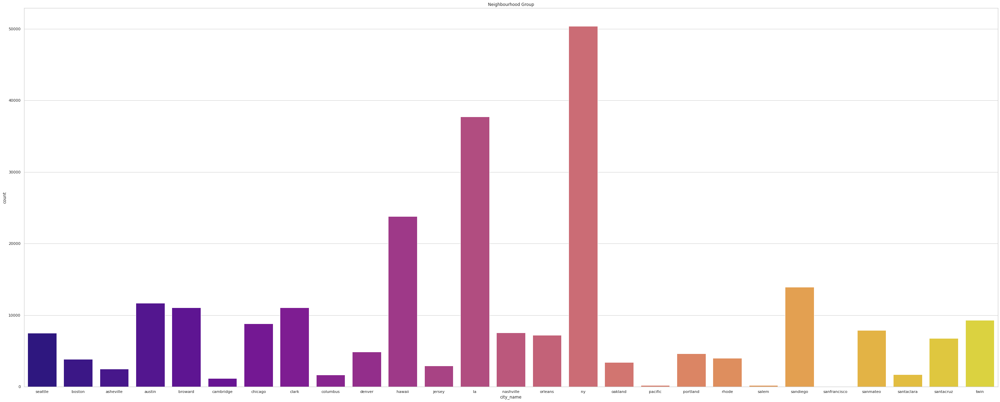

In [ ]:
sns.countplot(filtered_listings['city_name'],palette = "plasma")
fig = plt.gcf()
fig.set_size_inches(50,20)
plt.title('Neighbourhood Group')

In [ ]:
# drop all na records
filtered_listings.dropna()

,city_name,id,last_scraped,name,summary,description,host_id,host_name,host_since,host_location,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_verifications,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,amenities,square_feet,price,...,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,cancellation_policy,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_days_active,air_conditioning,high_end_electronics,bbq,balcony,nature_and_views,bed_linen,breakfast,tv,coffee_machine,cooking_basics,white_goods,elevator,gym,child_friendly,parking,outdoor_space,host_greeting,hot_tub_sauna_or_pool,internet,long_term_stays,pets_allowed,private_entrance,secure,self_check_in,smoking_allowed,accessible,event_suitable,time_since_first_review,time_since_last_review


Word Clouds

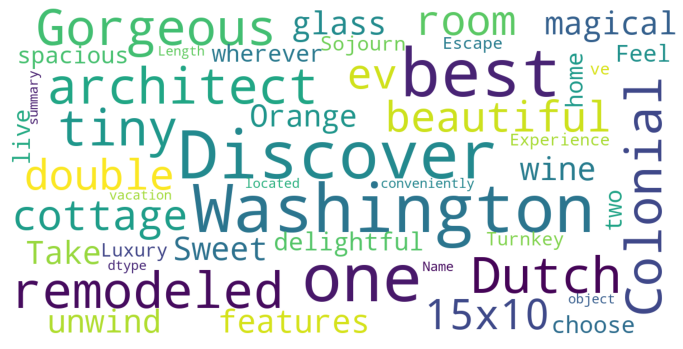

In [ ]:
# word cloud for summary
comment_words = ''
stopwords = set(STOPWORDS)

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=200,
        max_font_size=40, 
        scale=3,
        random_state=1 # chosen at random by flipping a coin; it was heads
    ).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

show_wordcloud(all_listings['summary'])

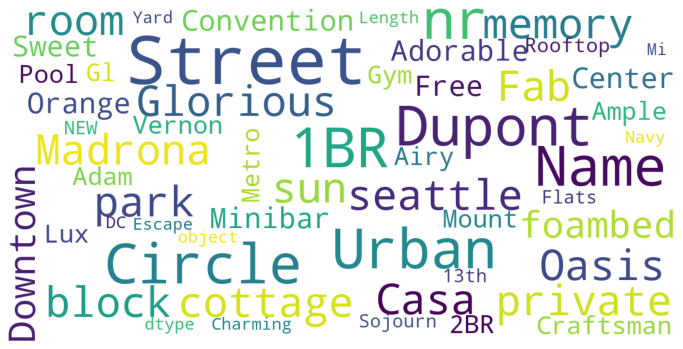

In [ ]:
# word cloud for names
comment_words = ''
stopwords = set(STOPWORDS)

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=200,
        max_font_size=40, 
        scale=3,
        random_state=1 # chosen at random by flipping a coin; it was heads
    ).generate(str(data))

    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

show_wordcloud(all_listings['name'])

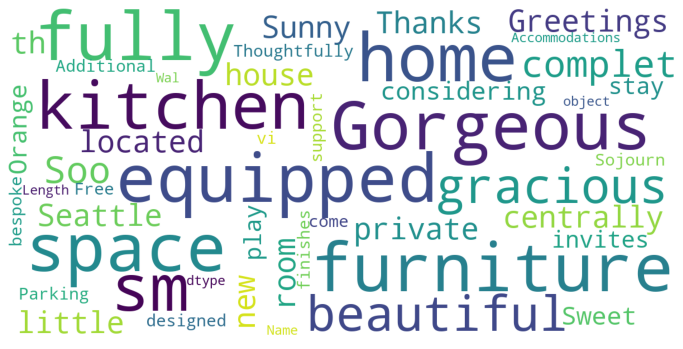

In [ ]:
# Word cloud for space
comment_words = ''
stopwords = set(STOPWORDS)

def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=200,
        max_font_size=40, 
        scale=3,
        random_state=1 # chosen at random by flipping a coin; it was heads
    ).generate(str(data))
 
    fig = plt.figure(1, figsize=(12, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

show_wordcloud(all_listings['space'])

## Exploratory Analysis

### Question: how long have hosts been listing properties on Airbnb in USA?

In [ ]:
print(f"Of the Airbnb hosts that are still listing on the site, the first joined on {min(filtered_listings.host_since).strftime('%d %B %Y')}, and the most recent joined on {max(filtered_listings.host_since).strftime('%d %B %Y')}.")

Of the Airbnb hosts that are still listing on the site, the first joined on 03 March 2008, and the most recent joined on 13 April 2020.


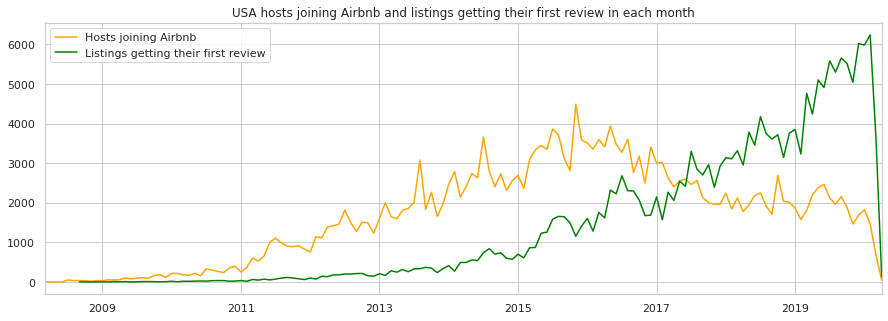

In [ ]:
plt.figure(figsize=(15,5))
filtered_listings.set_index('host_since').resample('MS').size().plot(label='Hosts joining Airbnb', color='orange')
filtered_listings.set_index('first_review').resample('MS').size().plot(label='Listings getting their first review', color='green')
plt.title('USA hosts joining Airbnb and listings getting their first review in each month')
plt.legend()
plt.xlim('2008-03-03', '2020-04-13') # Limiting to whole months
plt.xlabel('')
plt.ylabel('')
plt.show()

Answer: the oldest USA listing that is currently live on Airbnb was first listed on the site in March 2008. From 2011 onwards, the number of listings started increasing considerably. However, growth in the number of new hosts (of those currently listing on the site) has been decreasing since 2016.

A high level of seasonality is evident, with notable peaks in the summer when people put properties online to take advantage of the increased number of tourists in the summer holidays.

There is a big peak in the number of hosts joining Airbnb in the end of 2015.

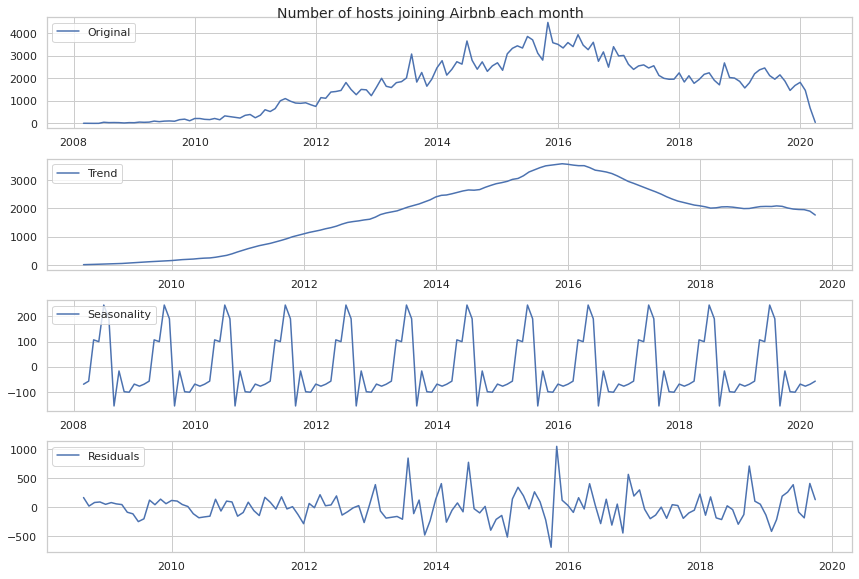

In [ ]:
# Creating dataframes for time series analysis
ts_host_since = pd.DataFrame(filtered_listings.set_index('host_since').resample('MS').size())
ts_first_review = pd.DataFrame(filtered_listings.set_index('first_review').resample('MS').size())

# Renaming columns
ts_host_since = ts_host_since.rename(columns={0: 'hosts'})
ts_host_since.index.rename('month', inplace=True)
ts_first_review = ts_first_review.rename(columns={0: 'reviews'})
ts_first_review.index.rename('month', inplace=True)

def decompose_time_series(df, title=''):
    """
    Plots the original time series and its decomposition into trend, seasonal and residual.
    """
    # Decomposing the time series
    decomposition = seasonal_decompose(df)
    
    # Getting the trend, seasonality and noise
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    
    # Plotting the original time series and the decomposition
    plt.figure(figsize=(12,8))
    plt.suptitle(title, fontsize=14, y=1)
    plt.subplots_adjust(top=0.80)
    plt.subplot(411)
    plt.plot(df, label='Original')
    plt.legend(loc='upper left')
    plt.subplot(412)
    plt.plot(trend, label='Trend')
    plt.legend(loc='upper left')
    plt.subplot(413)
    plt.plot(seasonal,label='Seasonality')
    plt.legend(loc='upper left')
    plt.subplot(414)
    plt.plot(residual, label='Residuals')
    plt.legend(loc='upper left')
    plt.tight_layout()

decompose_time_series(ts_host_since, title='Number of hosts joining Airbnb each month')

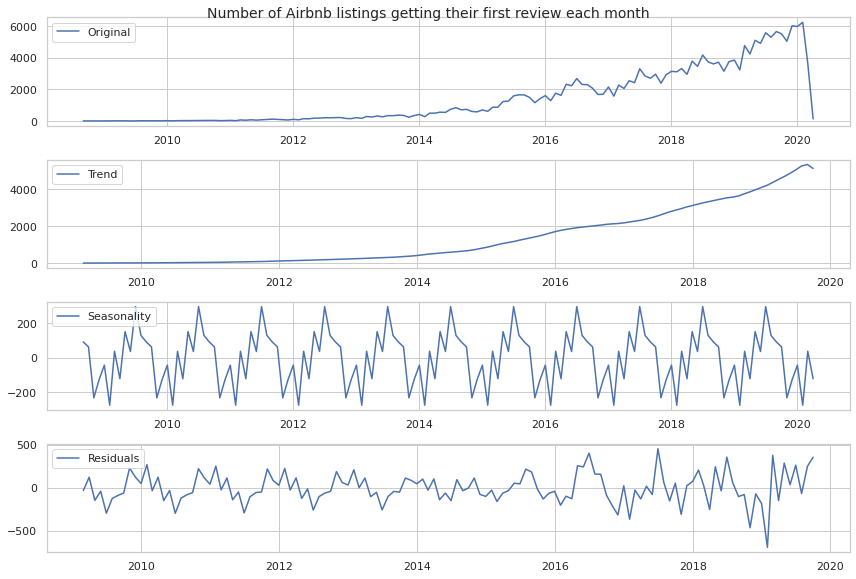

In [ ]:
decompose_time_series(ts_first_review, title='Number of Airbnb listings getting their first review each month')

## Descriptive Analysis

In [ ]:
#describing the listing data after cleaning
filtered_listings.describe()

,id,host_id,host_is_superhost,host_listings_count,host_total_listings_count,host_identity_verified,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,beds,square_feet,price,cleaning_fee,guests_included,extra_people,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_days_active,air_conditioning,high_end_electronics,bbq,balcony,nature_and_views,bed_linen,breakfast,tv,coffee_machine,cooking_basics,white_goods,elevator,gym,child_friendly,parking,outdoor_space,host_greeting,hot_tub_sauna_or_pool,internet,long_term_stays,pets_allowed,private_entrance,secure,self_check_in,smoking_allowed,accessible,event_suitable
count,2.459650e+05,2.459650e+05,245935.000000,245935.000000,245935.000000,245935.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,244338.000000,2255.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,245965.000000,198692.000000,245965.000000,197364.0,5487.0,41774.0,76911.0,13165.0,113028.0,23795.0,203349.0,137009.0,119771.0,183902.0,51016.0,40614.0,82945.0,188718.0,60282.0,22944.0,61553.0,240366.0,76493.0,49837.0,104883.0,27921.0,94514.0,9959.0,8174.0,13264.0
mean,2.479613e+07,9.042310e+07,0.348185,63.341692,63.341692,0.407555,35.701227,-102.227451,0.892383,4.025744,1.430024,1.534450,2.159337,885.637694,244.185299,84.628386,2.044482,12.877023,47.787254,160.388035,34.950871,13.221609,0.495009,17.157567,15.098124,1.329722,0.274539,1.757745,1228.175525,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
std,1.245470e+07,9.264392e+07,0.476396,280.262610,280.262610,0.491381,6.830418,26.027151,0.309897,2.816358,0.845655,1.148808,1.869326,1814.615816,713.266120,98.841047,1.979373,24.573993,35.850255,135.565737,62.276705,20.474240,0.499976,49.156410,48.169276,5.413297,2.873792,1.924146,852.384480,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,1.090000e+02,2.300000e+01,0.000000,0.000000,0.000000,0.000000,18.920990,-159.714900,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.010000,-370.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
25%,1.525712e+07,1.418729e+07,0.000000,1.000000,1.000000,0.000000,32.764360,-118.389260,1.000000,2.000000,1.000000,1.000000,1.000000,490.000000,75.000000,20.000000,1.000000,0.000000,0.000000,12.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.330000,599.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
50%,2.520968e+07,5.137009e+07,0.000000,2.000000,2.000000,0.000000,36.173860,-97.743930,1.000000,4.000000,1.000000,1.000000,2.000000,700.000000,125.000000,60.000000,1.000000,0.000000,57.000000,146.000000,9.000000,4.000000,0.000000,2.000000,1.000000,0.000000,0.000000,1.060000,1208.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
75%,3.600334e+07,1.463899e+08,1.000000,8.000000,8.000000,1.000000,40.728250,-74.071650,1.000000,5.000000,2.000000,2.000000,3.000000,1000.000000,215.000000,115.000000,2.000000,20.000000,83.000000,298.000000,41.000000,19.000000,1.000000,7.000000,4.000000,1.000000,0.000000,2.610000,1819.000000,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
max,4.318061e+07,3.437903e+08,1.000000,2354.000000,2354.000000,1.000000,47.734030,-70.995950,1.000000,80.000000,50.000000,37.000000

In [ ]:
#printing the correlation between all the columns of the listings
filtered_listings.corr()

,id,host_id,host_is_superhost,host_listings_count,host_total_listings_count,host_identity_verified,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,beds,square_feet,price,cleaning_fee,guests_included,extra_people,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,host_days_active,air_conditioning,high_end_electronics,bbq,balcony,nature_and_views,bed_linen,breakfast,tv,coffee_machine,cooking_basics,white_goods,elevator,gym,child_friendly,parking,outdoor_space,host_greeting,hot_tub_sauna_or_pool,internet,long_term_stays,pets_allowed,private_entrance,secure,self_check_in,smoking_allowed,accessible,event_suitable
id,1.000000,0.534626,-0.063775,0.106519,0.106519,-0.317033,-0.041924,-0.016255,-0.042022,0.081190,0.051920,0.041948,0.066180,-0.085598,0.048141,0.052129,0.010819,-0.073380,0.141514,0.041788,-0.386043,-0.102644,0.246040,0.122749,0.114900,0.068351,0.032091,0.152521,-0.515870,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
host_id,0.534626,1.000000,-0.092285,-0.054627,-0.054627,-0.438572,-0.036905,0.005883,-0.018395,0.053288,0.027631,0.033055,0.050607,-0.051802,0.026719,-0.020604,0.013915,-0.040592,0.130561,0.062325,-0.189071,-0.028819,0.211439,-0.030207,-0.032185,0.050163,0.002395,0.130272,-0.908957,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
host_is_superhost,-0.063775,-0.092285,1.000000,0.001903,0.001903,0.067841,-0.029471,-0.086065,0.028279,0.056005,0.010758,0.030885,0.047905,-0.007234,-0.045697,0.066129,0.078705,0.054267,0.093418,0.086032,0.317209,0.379228,-0.015583,0.000916,0.009163,-0.025987,-0.039317,0.307566,0.072839,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
host_listings_count,0.106519,-0.054627,0.001903,1.000000,1.000000,0.085640,0.027065,-0.026730,-0.079134,-0.009403,0.000615,-0.028107,-0.021646,-0.069402,0.084870,0.232685,-0.014264,-0.074251,0.050724,0.129345,-0.100076,-0.102687,0.071273,0.687201,0.698629,-0.014652,-0.005100,-0.087825,0.022143,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
host_total_listings_count,0.106519,-0.054627,0.001903,1.000000,1.000000,0.085640,0.027065,-0.026730,-0.079134,-0.009403,0.000615,-0.028107,-0.021646,-0.069402,0.084870,0.232685,-0.014264,-0.074251,0.050724,0.129345,-0.100076,-0.102687,0.071273,0.687201,0.698629,-0.014652,-0.005100,-0.087825,0.022143,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
host_identity_verified,-0.317033,-0.438572,0.067841,0.085640,0.085640,1.000000,0.073392,0.025603,0.001467,-0.061101,-0.047380,-0.044227,-0.062649,0.016425,-0.005155,-0.031589,-0.029252,0.027414,-0.084247,-0.050451,0.144156,0.016925,-0.165883,-0.003127,0.006345,-0.032263,0.004457,-0.067169,0.439972,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
latitude,-0.041924,-0.036905,-0.029471,0.027065,0.027065,0.073392,1.000000,0.597395,0.032793,-0.129938,-0.128680,-0.058023,-0.104514,-0.111841,-0.069520,-0.257569,-0.102439,0.035263,-0.094829,-0.156759,0.041534,0.026933,-0.118372,-0.116190,-0.128049,0.060588,0.007086,0.038293,0.059411,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
longitude,-0.016255,0.005883,-0.086065,-0.026730,-0.026730,0.025603,0.597395,1.000000,0.019718,-0.090357,-0.115386,-0.035658,-0.062081,-0.054253,-0.050301,-0.247592,-0.078988,0.032496,-0.069908,-0.119722,-0.023975,-0.022043,-0.083885,-0.162878,-0.166545,0.050272,-0.022430,-0.007482,0.015806,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

### What are the most popular cities in United States?

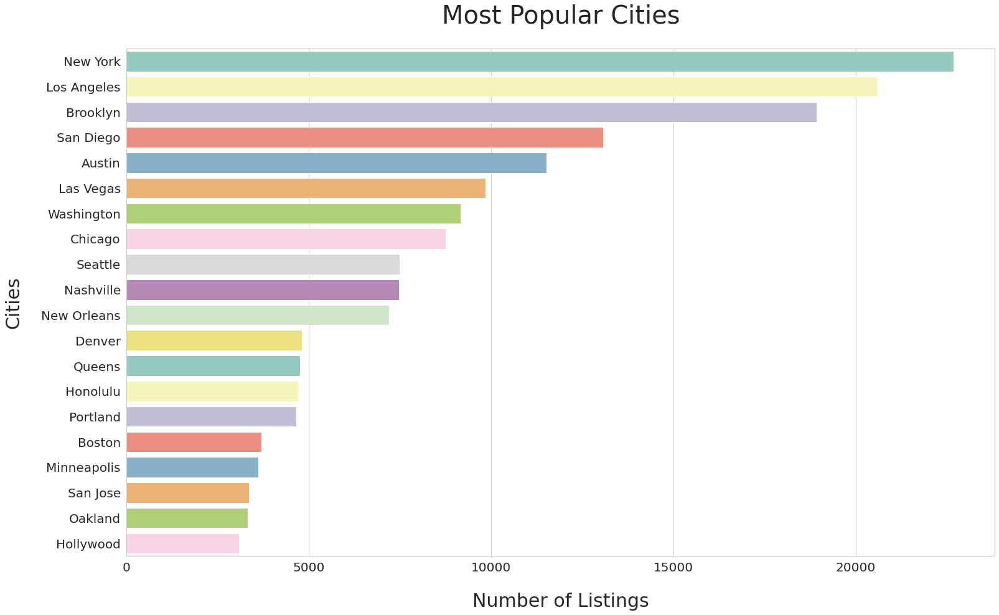

In [ ]:
# Plot top 20 Cities in terms listings
sns.set(style="whitegrid")
fig, ax = plt.subplots()
fig.set_size_inches(25, 15)
ax.axes.set_title("Most Popular Cities",fontsize=40,pad=40)
ax = sns.countplot(y='city',data=filtered_listings, order = filtered_listings['city'].value_counts().iloc[:20].index, palette="Set3")
ax.set_xlabel('Number of Listings',fontsize=30,labelpad=30)
ax.set_ylabel('Cities',fontsize=30,labelpad=30)
ax.xaxis.set_tick_params(labelsize=20)
ax.yaxis.set_tick_params(labelsize=20)

*Answer:*
*The top most popular cities are New York, Los Angeles and Brooklyn. Most customers are prefering these places to stay. So these areas are our main target.*

### What are the average room prices in various cities in the United States?




In [ ]:
# Create a list of top 20 cities in terms of listings
top = filtered_listings['city'].value_counts().iloc[:20].index.tolist()

In [ ]:
# Create a dataframe to group cities by average room price
price = pd.DataFrame(filtered_listings.groupby(['city']).price.mean().reset_index())

# Create a dataframe to filter top 20 neighbourhoods
top_price = price[price['city'].isin(top)].sort_values('price',ascending=False)

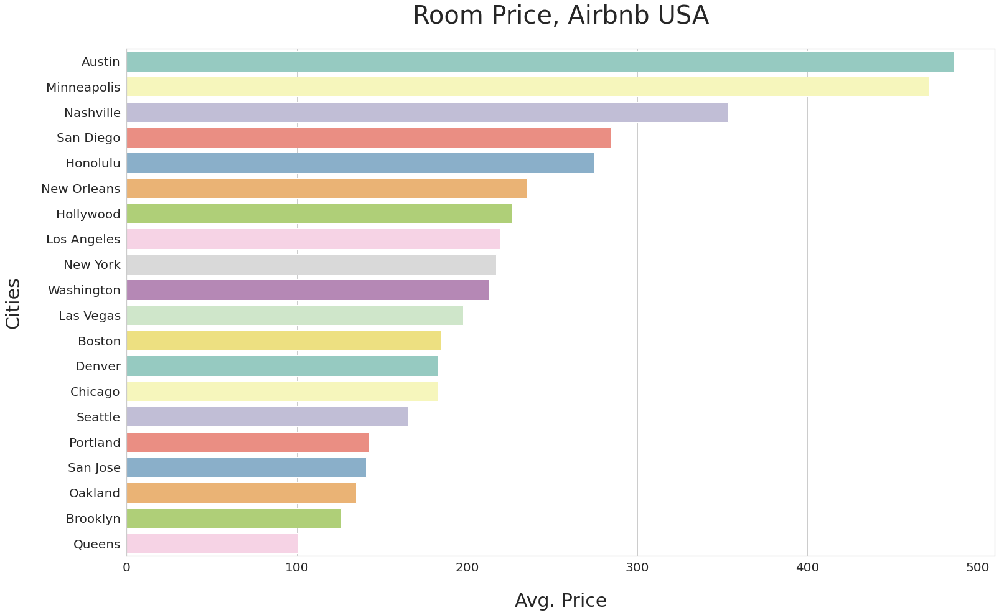

In [ ]:
# Barplot of price by cities, top 20 cities in terms of listings
fig, ax = plt.subplots()
fig.set_size_inches(25, 15)
ax.axes.set_title("Room Price, Airbnb USA",fontsize=40, pad=40)
ax = sns.barplot(x='price', y='city',data=top_price, palette='Set3')
ax.set_xlabel('Avg. Price',fontsize=30,labelpad=30)
ax.set_ylabel('Cities',fontsize=30,labelpad=30)
ax.xaxis.set_tick_params(labelsize=20)
ax.yaxis.set_tick_params(labelsize=20)

*Answer: Most of the room prices are less than 300$ which is affordable. However places like Austin have high room prices.*


### Question: Are the different patterns in the growth in the number of hosts and the number of listings due to hosts increasingly owning multiple properties?

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning:

divide by zero encountered in log

/usr/local/lib/python3.6/dist-packages/matplotlib/cbook/__init__.py:1157: RuntimeWarning:

invalid value encountered in double_scalars



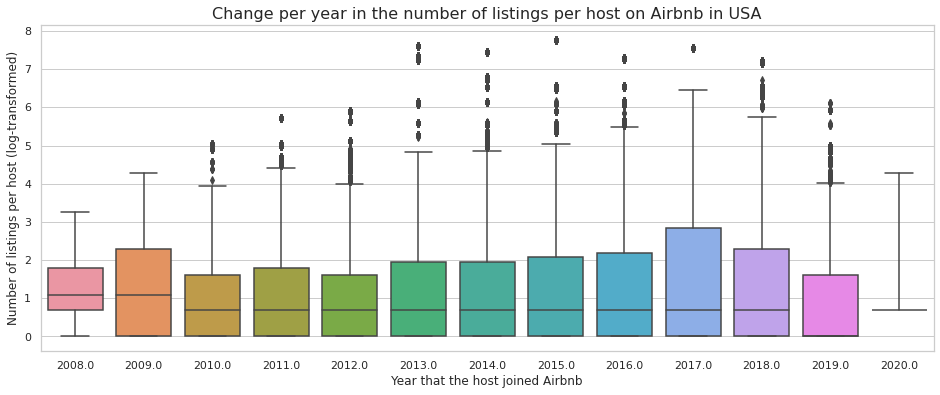

In [ ]:
plt.figure(figsize=(16,6))
sns.boxplot(filtered_listings.host_since.dt.year, np.log(filtered_listings.host_listings_count))
plt.xlabel('Year that the host joined Airbnb', fontsize=12)
plt.ylabel('Number of listings per host (log-transformed)', fontsize=12)
plt.title('Change per year in the number of listings per host on Airbnb in USA', fontsize=16)
plt.show()

In [ ]:
print("Average number of listings per host per year on Airbnb in USA:")
print(round(filtered_listings.set_index('host_since').host_listings_count.resample('YS').mean(),2))

Average number of listings per host per year on Airbnb in USA:
host_since
2008-01-01      6.53
2009-01-01     10.92
2010-01-01      9.43
2011-01-01     13.75
2012-01-01     17.40
2013-01-01    129.99
2014-01-01     50.72
2015-01-01    106.95
2016-01-01     72.16
2017-01-01     69.46
2018-01-01     45.44
2019-01-01      7.13
2020-01-01      4.46
Name: host_listings_count, dtype: float64


In [ ]:
!pip install folium            # install folium 
import folium                  #importing folium library 
import folium.plugins as plugins         #importing the plugins from the folium library
ny_map = folium.Map(location=[40.7,-74],zoom_start= 10)        #starting location of the map
data_loc = all_listings[['latitude','longitude']].values       #putting all the locations into data_loc
data_loc = data_loc.tolist()                          #making a list of locations 
hm = plugins.HeatMap(data_loc)                        #pluging in the data_loc to heatmap
hm.add_to(ny_map)                           #adding the headmap into the world map
ny_map                         #executing the map with Airbnb locaitons

In [ ]:
import folium

MAPdata = filtered_listings.copy()
MAPdata = MAPdata.sample(1000) #nlargest(100, 'log_price')
MAPdataloc = MAPdata[['latitude','longitude']]
MAPdatalist = MAPdataloc.values.tolist()
mapall = folium.Map(location=[42.3601, -71.0589], zoom_start=12)

for point in range(0, len(MAPdatalist)):
    folium.Marker(MAPdatalist[point], icon=folium.Icon(color='blue', icon='cloud')).add_to(mapall)    
    
mapall

In [ ]:
# List of the largest host_listings_count and the year the host joined Airbnb
filtered_listings.sort_values('host_listings_count').drop_duplicates('host_listings_count',keep='last').tail(10)[['host_name', 'city','host_since', 'host_listings_count']]

,host_name,city,host_since,host_listings_count
573,Stay Alfred,Columbus,2017-02-01,1931.0
2692,Stay Alfred,Nashville,2017-02-01,1932.0
1340,Stay Alfred,New Orleans,2013-02-04,2013.0
2498,Stay Alfred,Portland,2013-02-04,2014.0
6445,Stay Alfred,Austin,2013-02-04,2016.0
25784,Zeus,North Hollywood,2015-11-02,2324.0
44895,Zeus,New York,2015-11-02,2340.0
4115,Zeus,Cupertino,2015-11-02,2353.0
5880,Zeus,Seattle,2015-11-02,2354.0
7152,NaN,Washington,NaT,NaN


*Answer :There are a number of professional Airbnb management companies which host a large number of listings under a single host profile. The largest manages 2354 listings. This is management company based in Seattle operating under the name 'Zeus', while this company has top listings in other cities such as Cupertino, New York and North Hollywood.*

*However, there is no consistent upwards trend in the average number of properties managed by each host.*

### Question: How have prices changed over time?

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning:

divide by zero encountered in log



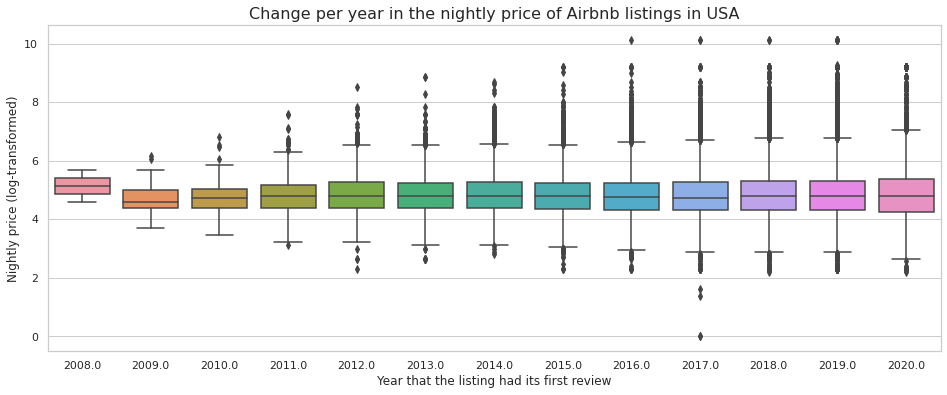

In [ ]:
plt.figure(figsize=(16,6))
sns.boxplot(filtered_listings.first_review.dt.year, np.log(filtered_listings.price))
plt.xlabel('Year that the listing had its first review', fontsize=12)
plt.ylabel('Nightly price (log-transformed)', fontsize=12)
plt.title('Change per year in the nightly price of Airbnb listings in USA', fontsize=16)
plt.show()

In [ ]:
print("Mean nightly price of listings in each year on Airbnb in USA:")
print(round(filtered_listings.set_index('first_review').price.resample('YS').mean(),2))

Mean nightly price of listings in each year on Airbnb in USA:
first_review
2008-01-01    198.00
2009-01-01    123.73
2010-01-01    131.63
2011-01-01    154.28
2012-01-01    168.57
2013-01-01    170.53
2014-01-01    172.92
2015-01-01    166.48
2016-01-01    173.61
2017-01-01    181.74
2018-01-01    188.01
2019-01-01    237.67
2020-01-01    297.92
Name: price, dtype: float64


*Answer: the average price per night for Airbnb listings in USA has increased drasticaly over the last 10 years. In particular, the top end of property prices has increased, resulting in a larger increase in the mean price compared to the median - e.g. the mean price in 2009 was $$123.73, whereas the mean price in 2019 (the last complete year of data) was $237.67.*

### Question: What is the overall distribution of prices?

In [ ]:
print(f"Nightly advertised prices range from ${min(filtered_listings.price)} to ${max(filtered_listings.price)}.")

Nightly advertised prices range from $0 to $94016.


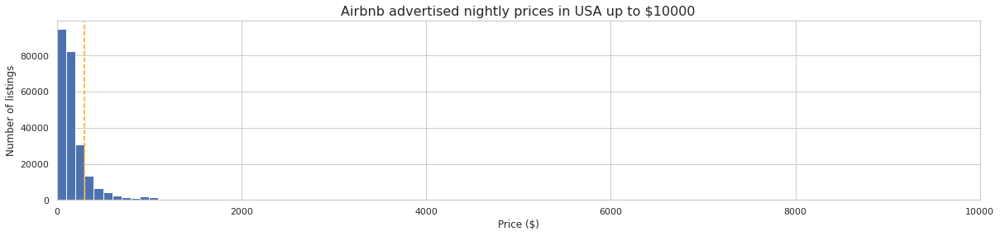

In [ ]:
# Distribution of prices from $0 to $10000
plt.figure(figsize=(20,4))
filtered_listings.price.hist(bins=100, range=(0,10000))
plt.margins(x=0)
plt.axvline(300, color='orange', linestyle='--')
plt.title("Airbnb advertised nightly prices in USA up to $10000", fontsize=16)
plt.xlabel("Price ($)")
plt.ylabel("Number of listings")
plt.show()

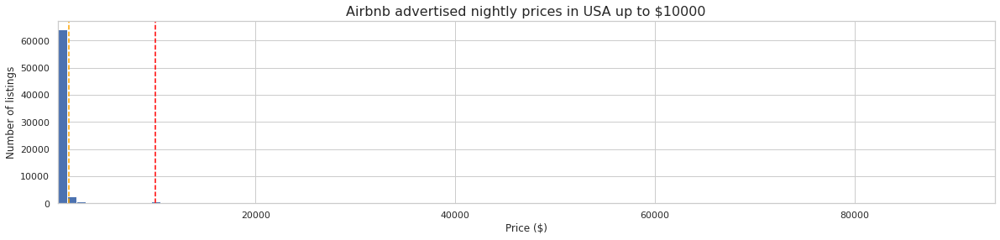

In [ ]:
# Distribution of prices from $1300 upwards
plt.figure(figsize=(20,4))
filtered_listings.price.hist(bins=100, range=(200, max(filtered_listings.price)))
plt.margins(x=0)
plt.axvline(1300, color='orange', linestyle='--')
plt.axvline(10000, color='red', linestyle='--')
plt.title("Airbnb advertised nightly prices in USA up to $10000", fontsize=16)
plt.xlabel("Price ($)")
plt.ylabel("Number of listings")
plt.show()

*Answer: nightly advertised prices range from $$0 to $94016. The extreme ends of the range are due to hosts not understanding how to use Airbnb advertised prices (sometimes called 'sticker' prices) correctly. The advertised prices can be set to any arbitrary amount, and these are the prices that show when dates are not entered on the site.*

*A model is only as good as its data, and unfortunately this model will be predicting advertised prices rather than the prices actually paid. Nevertheless, some cleaning of the particularly unhelpful values will be done. Very small values under $$100 will be increased to $100.*

*There are notable drop-offs in nightly prices at $300 (first graph, orange line), $$1300 (second graph, orange line) and $$10000 (second graph, red line). Values above $$10000 will be reduced to $$10000.*

In [ ]:
# Replacing values under $100 with $100
filtered_listings.loc[filtered_listings.price <= 100, 'price'] = 100

# Replacing values over $10000 with $10000
filtered_listings.loc[filtered_listings.price >= 10000, 'price'] = 10000

### Question: How many listings do hosts have on average? How many multi-listing hosts are there?

In [ ]:
print("Median number of listings per host:", int(filtered_listings.host_listings_count.median()))
print("Mean number of listings per host:", int(round(filtered_listings.host_listings_count.mean())))
print(f"{int(round(100*len(filtered_listings[filtered_listings.host_listings_count == 1])/len(filtered_listings)))}% of listings are from hosts with one listing.")

Median number of listings per host: 2
Mean number of listings per host: 63
36% of listings are from hosts with one listing.


*Answer: the median number of listings that the host of each listing has is 2, i.e. on average (median) each listing is hosted by a host who also manages one other listing. The mean is much higher (63 in total) due to some hosts managing large numbers of listings. About half of listings are from hosts with one listing, and half are from multi-listing hosts.*

*Two difficulties in discerning how many listings hosts have on average are:*
*   *this number is only known on the level of the listing, so hosts with more listings are represented more frequently (e.g a host with 10 listings may be represented up to 10 times in the dataset)*
*   *a host's other listings may not be in London, so some multi-listing hosts may appear multiple times in the dataset, and others may appear only once*

### Question: What are the average number of people accommodated in Airbnb listings in United States, and How do prices differ?

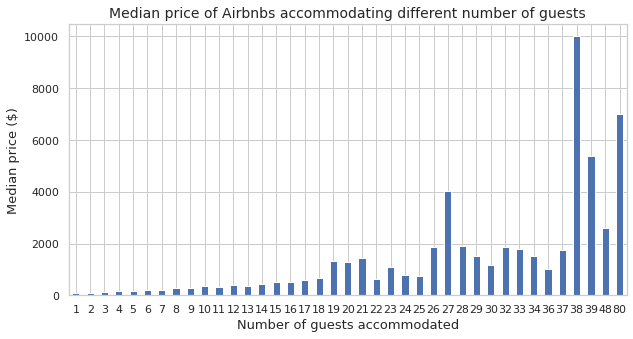

In [ ]:
plt.figure(figsize=(10,5))
filtered_listings.groupby('accommodates').price.median().plot(kind='bar')
plt.title('Median price of Airbnbs accommodating different number of guests', fontsize=14)
plt.xlabel('Number of guests accommodated', fontsize=13)
plt.ylabel('Median price ($)', fontsize=13)
plt.xticks(rotation=0)
plt.xlim(left=0.5)
plt.show()

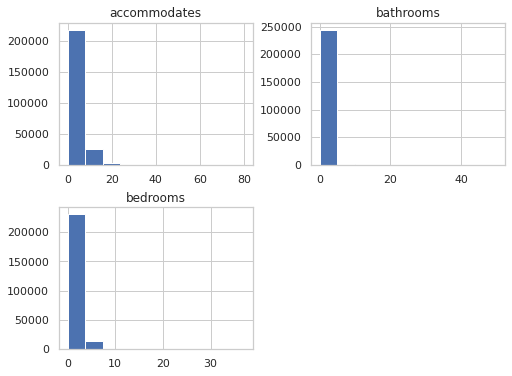

In [ ]:
filtered_listings[['accommodates', 'bathrooms', 'bedrooms']].hist(figsize=(8,6));

*Answer: the most common property setup sleeps two people in one bed in one bedroom, with one bathroom. Unsurprisingly, properties that accommodate more people achieve noticeably higher nightly rates, with diminishing returns coming after about 10 people.*

### Question: What are the most common property and room types?

In [ ]:
def category_count_plot(col, figsize=(8,4)):
    """
    Plots a simple bar chart of the total count for each category in the column specified.
    A figure size can optionally be specified.
    """
    plt.figure(figsize=figsize)
    filtered_listings[col].value_counts().plot(kind='bar')
    plt.title(col)
    plt.xticks(rotation=0)
    plt.show()

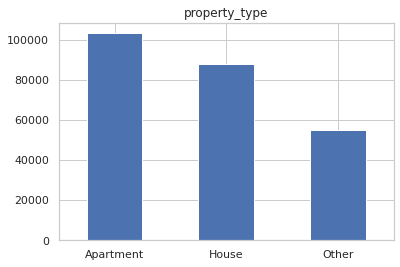

Apartment    0.419470
House        0.357067
Other        0.223463
Name: property_type, dtype: float64


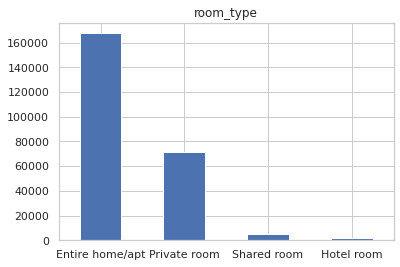

Entire home/apt    0.681280
Private room       0.290911
Shared room        0.019222
Hotel room         0.008587
Name: room_type, dtype: float64


In [ ]:
for col in ['property_type', 'room_type']:
    category_count_plot(col, figsize=(6,4))
    print(filtered_listings[col].value_counts(normalize=True))

*Answer:*

*About 41% of properties are apartments. The remaining are houses or more uncommon property types.About 68% of listings are entire homes (i.e. you are renting the entire property on your own). Most of the remaining are private rooms (i.e. you are renting a bedroom and possibly also a bathroom, but there will be other people in the property). Fewer than 1% are shared rooms and Hotel tooms (i.e. you are sharing a room with either the property owner or other guests).*

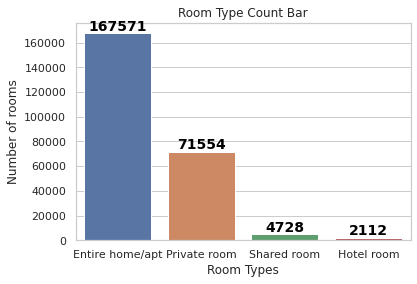

In [ ]:
room_type_plot = sns.countplot(x="room_type", order = filtered_listings.room_type.value_counts().index, data=filtered_listings)
room_type_plot.set(xlabel='Room Types', ylabel='Number of rooms', title='Room Type Count Bar')
for bar in room_type_plot.patches:
    h = bar.get_height()
    room_type_plot.text(
        bar.get_x() + bar.get_width()/2.,  # bar index (x coordinate of text)
        h,                                 # y coordinate of text
        '%d' % int(h),                     # y label
        ha='center', 
        va='bottom',
        color='black',
        fontweight='bold',
        size=14)
    
plt.show()

In [ ]:
ngp = filtered_listings['room_type'].value_counts().reset_index()
ngp.columns = ['room_type', 'Count']
ngp['Percent'] = ngp['Count']/ngp['Count'].sum() * 100

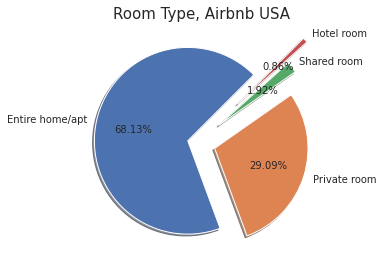

In [ ]:
import matplotlib.pyplot as plt

labels = ngp.room_type.tolist()
sizes = ngp['Percent'].tolist()
explodeT = (0.1,0.2,0.3,0.6)

fig1, ax1 = plt.subplots()
ax1.axes.set_title("Room Type, Airbnb USA",fontsize=15, pad=10)
ax1.pie(sizes, explode= explodeT, labels=labels, autopct='%1.2f%%',
        shadow=True, startangle=45,textprops={'fontsize': 10})
ax1.axis('equal')

plt.show()

*Its clear by pie chart also that more than 60% of the rooms listed are Entire home/apartment.*

### Question: How long are the listing available in an year?

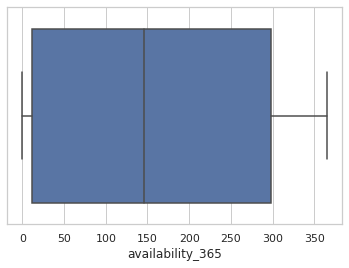

In [ ]:
import seaborn as sns
sns.set(style="whitegrid")
ax = sns.boxplot(x=filtered_listings["availability_365"])

*Answer: From the Plot above, we can see the IQR to be around 250(Length of the Box), meaning most listings are available for a maximum of 8 Months.*

### Question : Which room_type have highest security deposit?

In [ ]:
import plotly.express as px
#tips = px.data.tips()
fig = px.box(filtered_listings, x="room_type", y="security_deposit")
fig.show()

*Answer: Clearly, Entire home/apartment has highest security deposit because its more of resposibility taking the whole house or apartment. So for security reasons, the security deposit is high for that particular room type.*

###Question: what is the distribution of reviews like?

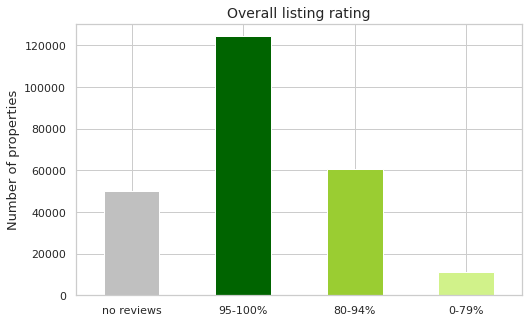

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(8,5))
ax.set_title('Overall listing rating', fontsize=14)
filtered_listings['review_scores_rating'].value_counts().sort_index(ascending=False).plot(kind='bar', color=['silver', 'darkgreen', 'yellowgreen', '#d1f28a' ], ax=ax)
ax.set_xticklabels(labels=['no reviews', '95-100%', '80-94%', '0-79%'], rotation=0)
ax.set_xlabel('')
ax.set_ylabel('Number of properties', fontsize=13)
plt.show()

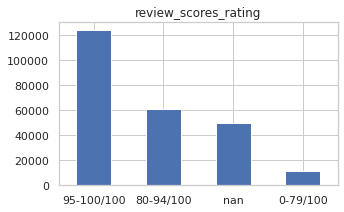

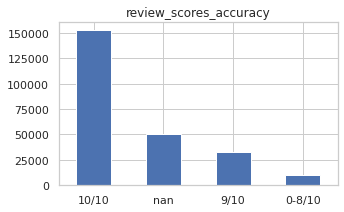

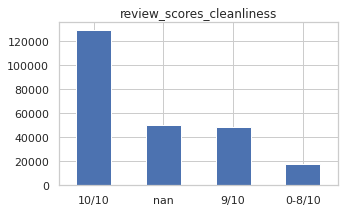

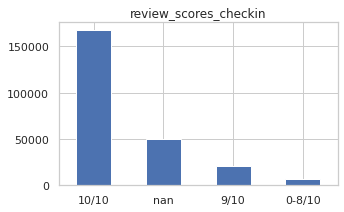

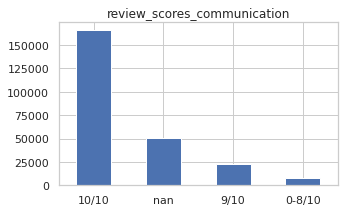

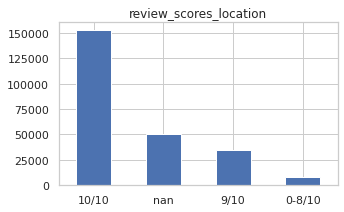

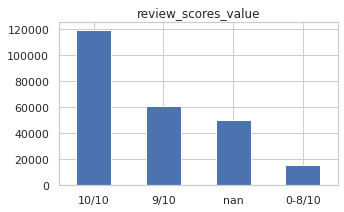

In [ ]:
for col in list(filtered_listings.columns[filtered_listings.columns.str.startswith("review_scores") == True]):
    category_count_plot(col, figsize=(5,3))

*Answer: for every review category, the majority of listings that have had a review have received a 10/10 rating for that category (or 95-100/100 overall) - clearly people love their Airbnbs. Ratings below 8 are quite rare. As observed previously, there are many listings that are not rated.*

### Question: How long have listings been on the site, and how many listings have been reviewed recently?

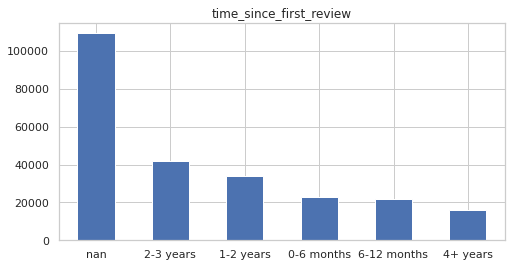

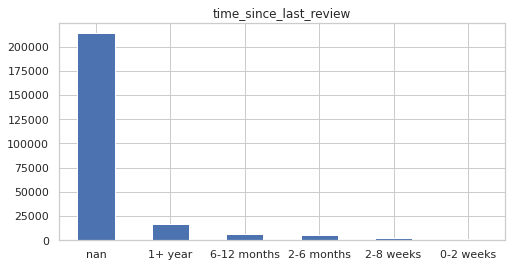

In [ ]:
for col in ['time_since_first_review', 'time_since_last_review']:
    category_count_plot(col)

*Answer: the most common time period the Airbnb listings had their first review is 2-3 years. This means that a lot of listings on the site have been active for at least a couple of years. Relatively few have been active for more than four years, however.*

*The most common category for the time since a listing received its last review is in 1+ years. This means that a lot of listings have been reviewed relatively last year. However, there are still lots of listings which have not had a review for more than a year. The majority of these are probably what are sometimes referred to 'inactive' listings, because although they are technically live on the site, they do not have their calendars open and are not available to book.*

## Predictive Analysis
In this section we will try to implement machine learning algorithms to predict the prices for airbnb listings. The algorithms will be used are as follows:
The models we used for this project are:
1.	Linear Regression
2.	Logistic Regression
3.	Random Forest Classifier
4.	Getting the Outliers

In [ ]:
# list all the prices in the dataset
filtered_listings['price']

0       296
1       100
2       100
3       100
4       165
       ... 
9289    100
9290    116
9291    124
9292    113
9293    185
Name: price, Length: 245965, dtype: int64

In [ ]:
# list all the ids in the data frame
filtered_listings.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 245965 entries, 0 to 9293
Data columns (total 95 columns):
 #   Column                                        Non-Null Count   Dtype         
---  ------                                        --------------   -----         
 0   city_name                                     245965 non-null  object        
 1   id                                            245965 non-null  int64         
 2   last_scraped                                  245965 non-null  object        
 3   name                                          245938 non-null  object        
 4   summary                                       236374 non-null  object        
 5   description                                   240469 non-null  object        
 6   host_id                                       245965 non-null  int64         
 7   host_name                                     245935 non-null  object        
 8   host_since                                    245935 non

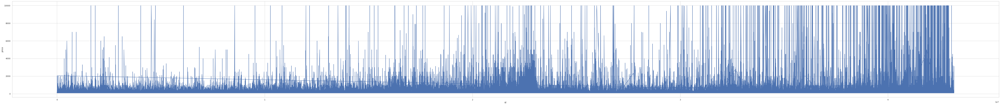

,id,price
6427,37564617,10000
2823,36269353,10000
2825,36269751,10000
3235,39772695,10000
3236,39772945,10000
...,...,...
8335,39719552,10000
8336,39719609,10000
8337,39719691,10000
8338,39719782,10000


In [ ]:
# distribution of prices of each listings in the dataset

%matplotlib inline
from matplotlib import pyplot as plt

plt.figure(figsize = (100,10))
plt.plot(filtered_listings['id'], filtered_listings['price'] )
plt.xlabel('id')
plt.ylabel('price')
plt.show()

# list of ids that have maximum values (price = 10000)
df = pd.DataFrame(filtered_listings, columns = ['id', 'price'])
outlier = df['price'] == 10000
df[outlier]

In [ ]:
# Column adjustments by assigning the mean value for all NA and inifinity
filtered_listings['accommodates'].replace([np.inf, -np.inf], np.nan, inplace=True)
filtered_listings['accommodates'].fillna(filtered_listings['accommodates'].mean(), inplace=True)

filtered_listings['bathrooms'].replace([np.inf, -np.inf], np.nan, inplace=True)
filtered_listings['bathrooms'].fillna(filtered_listings['bathrooms'].mean(), inplace=True)

filtered_listings['bedrooms'].replace([np.inf, -np.inf], np.nan, inplace=True)
filtered_listings['bedrooms'].fillna(filtered_listings['bedrooms'].mean(), inplace=True)

filtered_listings['beds'].replace([np.inf, -np.inf], np.nan, inplace=True)
filtered_listings['beds'].fillna(filtered_listings['beds'].mean(), inplace=True)

filtered_listings['square_feet'].replace([np.inf, -np.inf], np.nan, inplace=True)
filtered_listings['square_feet'].fillna(filtered_listings['square_feet'].mean(), inplace=True)

## **Outlier Detection**
####In this section the outlier will be detected in the dataset. Outliers or anomalies are those data points in the dataset that differs significantly from the other data points in the dataset. These outliers causes the prediction models to work less efficiently since they affect the mean value.
####In order to implement that detection and to make our data more clean Support Vector Machine Method will be used to classify the outliers away from the normal data.

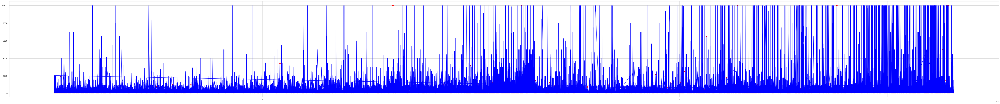

In [ ]:
# Support Vector Machine method to detect the outliers in the dataset

from sklearn.preprocessing import StandardScaler  #importing essential libraries
from sklearn.svm import OneClassSVM
outliers_fraction = 0.01  #equal to 3 standard deviation 

attribute_data = filtered_listings[['price', 'id', 'accommodates','bathrooms', 'bedrooms','beds','square_feet']] #attributes to be contributed to detect the outliers
scaler = StandardScaler()
np_scaled = scaler.fit_transform(attribute_data)
attribute_data = pd.DataFrame(np_scaled)

# train oneclassSVM 
model = OneClassSVM(nu=outliers_fraction, kernel="rbf", gamma=0.01)
model.fit(attribute_data)
filtered_listings['anomaly'] = pd.Series(model.predict(attribute_data)) #creating column named anomaly to classify the data value 

fig, ax = plt.subplots(figsize=(100,10))
a = filtered_listings.loc[filtered_listings['anomaly'] == -1, ['id', 'price']] #anomaly values to be classified as -1 and non anomalies to be as 1

#plotting the graph in which anoamlies are flagged as color red and non anomalies are as color blue
ax.plot(filtered_listings['id'], filtered_listings['price'], color='blue')
ax.scatter(a['id'],a['price'], color='red')
plt.show();


In [ ]:
# Drop columns that are not required
filtered_listings.drop([ 'last_scraped','host_since','host_location','host_response_time','host_response_rate','host_acceptance_rate','host_listings_count',
             'host_total_listings_count','city','state','latitude','longitude',
             'room_type','bathrooms','bedrooms','beds','square_feet',
             'security_deposit','cleaning_fee','guests_included',
           'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'instant_bookable',
        'calculated_host_listings_count',       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'reviews_per_month'
       ], axis=1, inplace=True)

**Building the dataset for Linear Regression Model**

In [ ]:
# create a dataframe  with the required columns
host = all_listings[['id','last_scraped','name','host_id','access','host_since','host_location','host_response_time','host_response_rate','host_acceptance_rate','host_listings_count',
             'host_total_listings_count','city','state','latitude','longitude',
             'room_type','accommodates','bathrooms','bedrooms','beds','square_feet',
             'price','weekly_price','monthly_price','security_deposit',
             'cleaning_fee','guests_included','minimum_nights','maximum_nights',
             'has_availability','availability_30','availability_60','availability_90',
             'availability_365','number_of_reviews','review_scores_rating',
             'review_scores_accuracy','review_scores_cleanliness',
             'review_scores_checkin','review_scores_communication','instant_bookable',
             'is_business_travel_ready','calculated_host_listings_count',
             'calculated_host_listings_count_entire_homes',
             'calculated_host_listings_count_private_rooms',
             'calculated_host_listings_count_shared_rooms',
             'reviews_per_month']]

host = host.fillna(0)

host['id']=pd.to_numeric(host['id'], errors= 'coerce')
host.sort_values(by=host.columns[0])
hosttable = sorted(set(host.iloc[:,0].values))


#changing the data type of essential column in host dataframe to numeric type
host['last_scraped'] = pd.to_datetime(host['last_scraped'], errors= 'coerce')
host['host_id']=pd.to_numeric(host['host_id'], errors= 'coerce')
host['host_since'] = pd.to_datetime(host['host_since'], errors= 'coerce')
host['host_response_rate']= host['host_response_rate'].apply(str).str.replace('%','')
host['host_response_rate']=pd.to_numeric(host['host_response_rate'], errors= 'coerce')
host['host_acceptance_rate']= host['host_acceptance_rate'].apply(str).str.replace('%','')
host['host_acceptance_rate']=pd.to_numeric(host['host_acceptance_rate'], errors= 'coerce')
host['host_listings_count']= pd.to_numeric(host['host_listings_count'], errors='coerce')
host['host_total_listings_count']=pd.to_numeric(host['host_total_listings_count'], errors = 'coerce')
host['accommodates']=pd.to_numeric(host['accommodates'], errors = 'coerce')
host['bathrooms']=pd.to_numeric(host['bathrooms'], errors = 'coerce')
host['beds']=pd.to_numeric(host['beds'], errors = 'coerce')
host['bedrooms']=pd.to_numeric(host['bedrooms'], errors = 'coerce')
host['square_feet']=pd.to_numeric(host['square_feet'], errors = 'coerce')
host['guests_included']=pd.to_numeric(host['guests_included'], errors = 'coerce')
host['minimum_nights']=pd.to_numeric(host['minimum_nights'], errors = 'coerce')
host['maximum_nights']=pd.to_numeric(host['maximum_nights'], errors = 'coerce')
host['availability_30']=pd.to_numeric(host['availability_30'], errors = 'coerce')
host['availability_60']=pd.to_numeric(host['availability_60'], errors = 'coerce')
host['availability_90']=pd.to_numeric(host['availability_90'], errors = 'coerce')
host['availability_365']=pd.to_numeric(host['availability_365'], errors = 'coerce')
host['number_of_reviews']=pd.to_numeric(host['number_of_reviews'], errors = 'coerce')
host['review_scores_rating']=pd.to_numeric(host['review_scores_rating'], errors = 'coerce')
host['review_scores_accuracy']=pd.to_numeric(host['review_scores_accuracy'], errors = 'coerce')
host['review_scores_cleanliness']=pd.to_numeric(host['review_scores_cleanliness'], errors = 'coerce')
host['review_scores_checkin']=pd.to_numeric(host['review_scores_checkin'], errors = 'coerce')
host['review_scores_communication']=pd.to_numeric(host['review_scores_communication'], errors = 'coerce')
host['calculated_host_listings_count']=pd.to_numeric(host['calculated_host_listings_count'], errors = 'coerce')
host['calculated_host_listings_count_entire_homes']=pd.to_numeric(host['calculated_host_listings_count_entire_homes'], errors = 'coerce')
host['calculated_host_listings_count_private_rooms']=pd.to_numeric(host['calculated_host_listings_count_private_rooms'], errors = 'coerce')
host['calculated_host_listings_count_shared_rooms']=pd.to_numeric(host['calculated_host_listings_count_shared_rooms'], errors = 'coerce')
host['reviews_per_month']=pd.to_numeric(host['reviews_per_month'], errors = 'coerce')
host['price'] = host['price'].apply(str).str.replace('$','')
host['price'] = host['price'].apply(str).str.replace(',','')
host['price']=pd.to_numeric(host['price'], errors= 'coerce')
host['weekly_price'] = host['weekly_price'].apply(str).str.replace('$','')
host['weekly_price'] = host['weekly_price'].apply(str).str.replace(',','')
host['weekly_price']=pd.to_numeric(host['weekly_price'], errors= 'coerce')
host['monthly_price'] = host['monthly_price'].apply(str).str.replace('$','')
host['monthly_price'] = host['monthly_price'].apply(str).str.replace(',','')
host['monthly_price']=pd.to_numeric(host['monthly_price'], errors= 'coerce')
host['security_deposit'] = host['security_deposit'].apply(str).str.replace('$','')
host['security_deposit'] = host['security_deposit'].apply(str).str.replace(',','')
host['security_deposit']=pd.to_numeric(host['security_deposit'], errors= 'coerce')
host['cleaning_fee'] = host['cleaning_fee'].apply(str).str.replace('$','')
host['cleaning_fee'] = host['cleaning_fee'].apply(str).str.replace(',','')
host['cleaning_fee']=pd.to_numeric(host['cleaning_fee'], errors= 'coerce')


#again dropping non essential column in the host dataframe
host.drop([ 'last_scraped','access','host_since','host_location','host_response_time','host_response_rate','host_acceptance_rate','host_listings_count',
             'host_total_listings_count','city','state','latitude','longitude',
             'room_type','bathrooms','bedrooms','beds','square_feet',
             'security_deposit','cleaning_fee','guests_included', 'has_availability',
           'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'instant_bookable',
       'is_business_travel_ready', 'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'reviews_per_month'], axis=1, inplace=True)





In [ ]:
#final information about the host column
host.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 245965 entries, 0 to 9293
Data columns (total 16 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   id                      245965 non-null  int64  
 1   name                    245965 non-null  object 
 2   host_id                 245965 non-null  int64  
 3   accommodates            245965 non-null  int64  
 4   price                   245965 non-null  float64
 5   weekly_price            245965 non-null  float64
 6   monthly_price           245965 non-null  float64
 7   minimum_nights          245965 non-null  int64  
 8   maximum_nights          245965 non-null  int64  
 9   availability_30         245965 non-null  int64  
 10  availability_60         245965 non-null  int64  
 11  availability_90         245965 non-null  int64  
 12  availability_365        245965 non-null  int64  
 13  number_of_reviews       245965 non-null  int64  
 14  review_scores_rating  

##**Linear Regression**
The Airbnb prices can be predicted using the Linear Regression model by using the attributes below:
latitude, longitude, city, accommodates, bathrooms, review scores rating, number of reviews including the price as well. 

We try to fit the data into a linear relationship by keeping one of the attributes as independent and others are kept as dependent attributes. The correlation is given in order to look at the effect and relation between various attributes. We are able to look at the strength and effect of certain attribute on the dependent variables. 

After plotting the data points linearly, the model can be tested for the independent variable by looking at the effect on dependent variables.

In [ ]:
# Importing libraries to implement the Linear Regression method for prediction analysis
from sklearn.linear_model import LinearRegression
from sklearn import linear_model

numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64','uint8']  
numericdataX = host.select_dtypes(include=numerics) #dataframe named numericdataX containing numeric values of required columns
x= numericdataX['accommodates']
numericdataX.head()

,id,host_id,accommodates,price,weekly_price,monthly_price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy
0,2318,2536,9,296.0,0.0,0.0,7,1000,26,56,86,86,32,100.0,10.0
1,6606,14942,2,90.0,670.0,0.0,30,1125,0,16,45,45,150,92.0,9.0
2,9419,30559,2,62.0,580.0,1500.0,2,180,30,60,90,365,148,93.0,10.0
3,9460,30832,2,79.0,0.0,0.0,3,29,10,10,10,10,466,98.0,10.0
4,9531,31481,4,165.0,1075.0,3000.0,3,730,3,33,63,276,40,100.0,10.0


/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4172: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/pandas/core/generic.py:6245: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



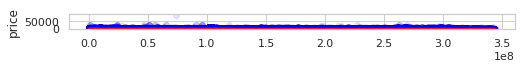

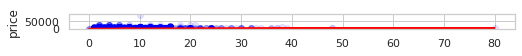

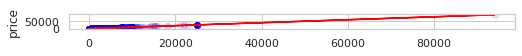

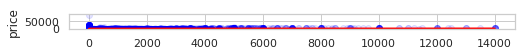

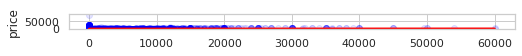

...

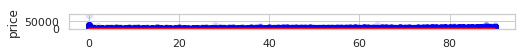

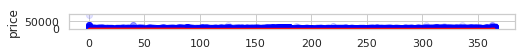

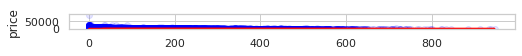

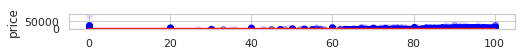

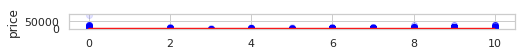

In [ ]:
# replacing all infinity and nan values in the nuemricdataX dataframe with the mean value 
numericdataX.replace([np.inf, -np.inf], np.nan, inplace=True)
numericdataX.fillna(numericdataX.mean(), inplace=True)  


regressor = linear_model.LinearRegression()
for i in range(1,15): 
    x= np.array(numericdataX.iloc[:,i]).reshape(-1,1)
    y= np.array(host['price']).reshape(-1,1)

    regressor.fit(x,y)

# plotting the linear relation between price (y-axis) and other attributes (x-axis) relating to price
    plt.figure(figsize=(8,5))
    plt.subplot(15,1,i)
    plt.scatter(x,y,color='blue', alpha=0.1)
    plt.plot(x,regressor.predict(x),color="red")
    plt.ylabel('price')



In [ ]:
import statsmodels.formula.api as sm
from statsmodels.formula.api import ols


In [ ]:
#definition to check the correlation between the attributes
def checkCorrelation(data):
    plt.figure(figsize=(20, 20))
    sns.heatmap(host.corr(),linewidths=0.25,vmax=1.0,square=True,cmap="BuGn_r", 
    linecolor='w',annot=True)

In [ ]:
#return Model 
def data_model(xdata):
    #add constant to data
    X = sm.add_constant(xdata)
    targetY=host[['price']]
    y = targetY
    # Fit the linear model
    model = linear_model.LinearRegression()
    results = model.fit(X, y)
    model = sm.OLS(y, X)
    results = model.fit()
    return results

In [ ]:
def crossValidationError(data):
    numericdataX=data
    X = np.array(numericdataX.drop(['price'],axis=1), dtype=pd.Series)
    Y = np.array(numericdataX['price'], dtype=pd.Series)
    regr1 = linear_model.LinearRegression()
    ms_errors= cross_val_score(regr1, X, Y, cv=5, scoring = make_scorer(mean_squared_error))
    rms_errors = np.sqrt(ms_errors)
    mean_rms_error = rms_errors.mean()
    return mean_rms_error

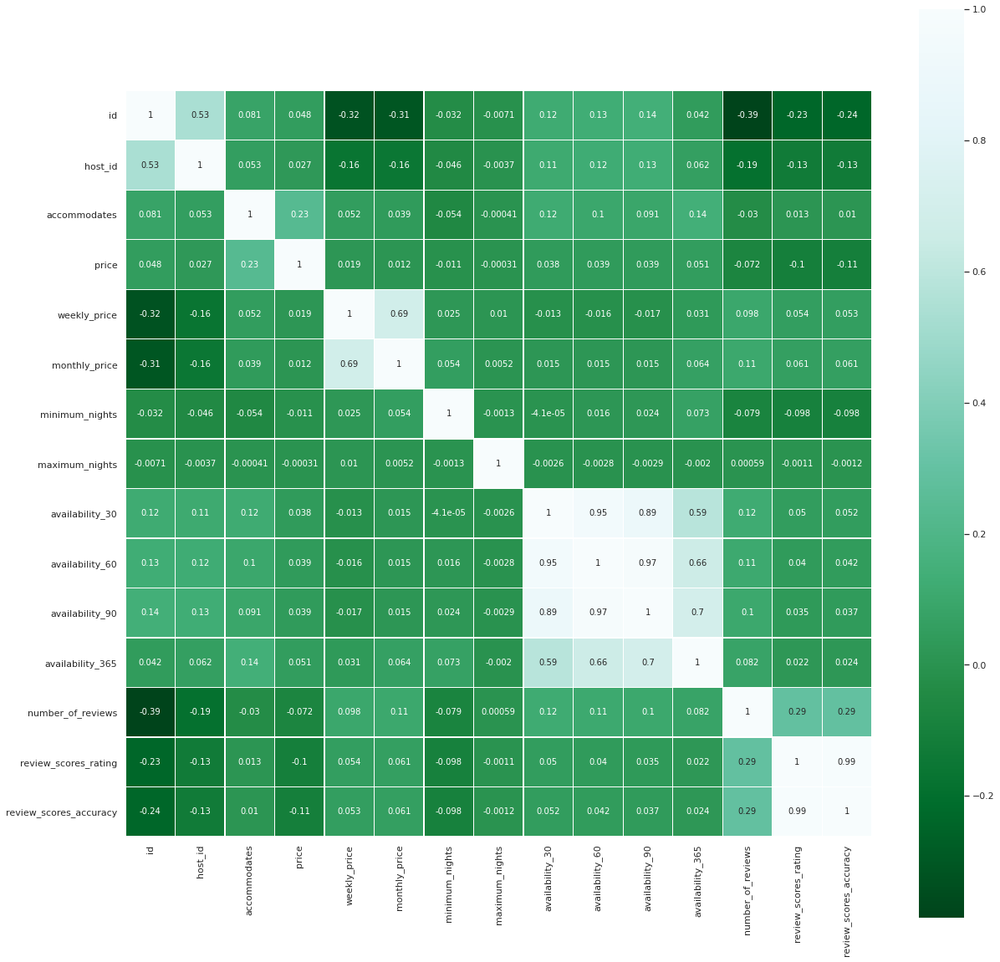

In [ ]:
checkCorrelation(numericdataX) #calling the function checkCorrelation with the parameter numericdataX dataframe

In [ ]:
host=host.drop(['id','host_id','availability_30',
       'availability_60', 'availability_90', 'number_of_reviews',
                'review_scores_rating' ,'review_scores_accuracy'], axis=1)


In [ ]:
#importing all essential libraries for Linear Regression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split


In [ ]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import r2_score

In [ ]:
#Defining the independent variables and dependent variables
x = host.iloc[:,[2,3,4,5,6,7]]
y = host['price']
#Getting Test and Training Set
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.1,random_state=353)
x_train.head()
y_train.head()

31634      60.0
3523     1000.0
19341     275.0
847        89.0
1476      200.0
Name: price, dtype: float64

In [ ]:
x_train.shape

(221368, 6)

In [ ]:

#Prepare a Linear Regression Model
reg=LinearRegression()
reg.fit(x_train,y_train)
y_pred=reg.predict(x_test)
from sklearn.metrics import r2_score
r2_score(y_test,y_pred)

1.0

In [ ]:
x1 = host[['accommodates','minimum_nights','maximum_nights','availability_365']].values
y1 = host['price'].values

In [ ]:
from sklearn import metrics

##**Comparison between predicted and actual prices**
The graph shows the difference in the actual prices and the prices predicted by the linear regression model. After looking at the graph, we are able to analyze how the actual price varies from the predicted prices by which we are able to calculate the mean squared error to check how much accurate the model is for predicting the prices based on certain features.

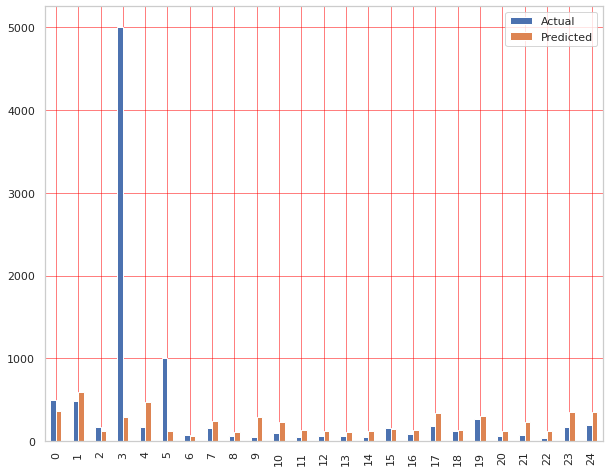

Mean Square Error -  338.5245418221143
Root Mean Square Error -  0.5818286189438556


In [ ]:

from sklearn.model_selection import train_test_split 
x1_train, x1_test, y1_train, y1_test = train_test_split(x1, y1, test_size=0.1, random_state=0) #dividing the data for training and testing

regression1 = LinearRegression()  #taking regressor to be linear regressor
regression1.fit(x1_train, y1_train)
y1_pred = regression1.predict(x1_test)

#comapring the predicted and actual values for price
df = pd.DataFrame({'Actual': y1_test, 'Predicted': y1_pred})
df1 = df.head(25)
df1

#plotting the graph to see the comaparision between actual and predicted values
df1.plot(kind='bar',figsize=(10,8))
plt.grid(which='major', linewidth='0.5', color='red')
plt.grid(which='minor', linewidth='0.5', color='blue')
plt.show()

#printing out the MSE and RMSE values for the analysis of the algorithm
print('Mean Square Error - ', (metrics.mean_squared_error(y1_test, y1_pred)*0.001))  
print('Root Mean Square Error - ', np.sqrt(metrics.mean_squared_error(y1_test, y1_pred))*0.001)

In [ ]:

calc = all_listings[['id','neighbourhood','latitude','longitude','room_type','accommodates','bathrooms','bedrooms','number_of_reviews','review_scores_rating']]

In [ ]:
calc['accommodates']=pd.to_numeric(calc['accommodates'], errors = 'coerce')
calc['bathrooms']=pd.to_numeric(calc['bathrooms'], errors = 'coerce')
calc['bedrooms']=pd.to_numeric(calc['bedrooms'], errors = 'coerce')
calc['review_scores_rating']=pd.to_numeric(calc['review_scores_rating'], errors = 'coerce')
calc['latitude']=pd.to_numeric(calc['latitude'], errors = 'coerce')
calc['number_of_reviews']=pd.to_numeric(calc['number_of_reviews'], errors = 'coerce')
calc['longitude']=pd.to_numeric(calc['longitude'], errors = 'coerce')
calc['id']=pd.to_numeric(calc['id'], errors= 'coerce')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

In [ ]:
def checkCorrelation(data):  # the function to check the correlation between attributes
    plt.figure(figsize=(20, 20))
    sns.heatmap(data.corr(),linewidths=0.25,vmax=1.0,square=True,cmap="BuGn_r", 
    linecolor='w',annot=True)


In [ ]:
#return Model 
def data_model(xdata):
    """
     fits linear regression model on given data
    :param xdata: independent variable dataset
    :return: linear regression model with fit of xdata 
   """
    #add constant to data
    X = sm.add_constant(xdata)
    targetY=calc[['price']]
    y = targetY

    # Fit the linear model
    model = linear_model.LinearRegression()
    results = model.fit(X, y)
    model = sm.OLS(y, X)
    results = model.fit()
    return results

In [ ]:
#return Model 
def data_model(xdata):
    
    #add constant to data
    X = sm.add_constant(xdata)
    targetY=calc[['price']]
    y = targetY

    # Fit the linear model
    model = linear_model.LinearRegression()
    results = model.fit(X, y)
    model = sm.OLS(y, X)
    results = model.fit()
    return results

In [ ]:
def data_summary(xdata):  #gives the summary of all the variables from the data
    results = data_model(xdata)
    return results.summary()

In [ ]:
def crossValidationError(data):  #calcualting the cross validation error
    numericdataX=calc
    X = np.array(numericdataX.drop(['price'],axis=1), dtype=pd.Series)
    Y = np.array(numericdataX['price'], dtype=pd.Series)
    regr1 = linear_model.LinearRegression()
    ms_errors= cross_val_score(regr1, X, Y, cv=5, scoring = make_scorer(mean_squared_error))
    rms_errors = np.sqrt(ms_errors)
    mean_rms_error = rms_errors.mean()
    return mean_rms_error

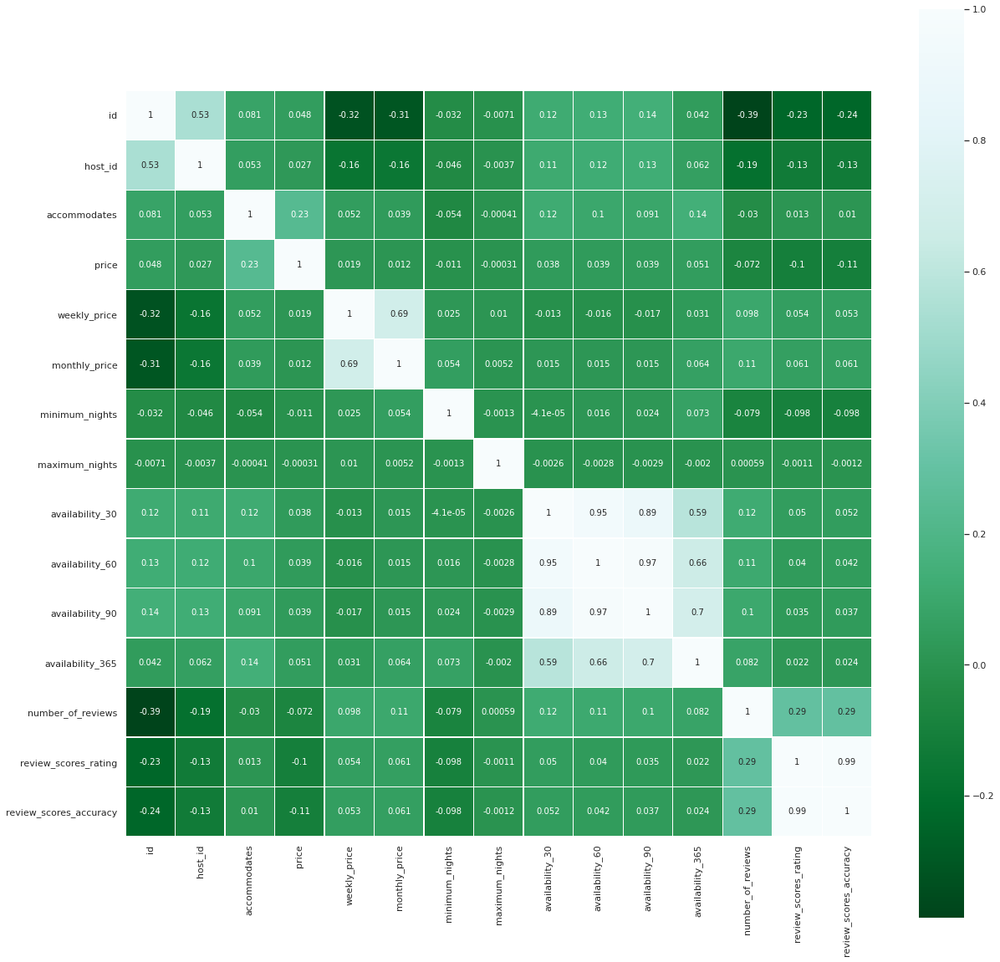

In [ ]:
#Checking correlation in data
checkCorrelation(numericdataX)

##**Logistic Regression**
For the logistic regression, instead of plotting a linear relation between the independent and dependent variables we divide the dataset into the train and test data to get the logistic relation. In our project, we divide the training and testing data as 80% and 20% respectively. 

In this model, we first train some part of the data for which the prices are already given. Then, we get a logistic equation representing the probability of the price. 

After getting the probability of the prices using the trained data, we predict the prices for the testing data by using the logistic equation which was found using the training data.

Accuracy of logistic regression classifier on test set: 0.78
[[38460     1]
 [10732     0]]
              precision    recall  f1-score   support

         0.0       0.78      1.00      0.88     38461
         1.0       0.00      0.00      0.00     10732

    accuracy                           0.78     49193
   macro avg       0.39      0.50      0.44     49193
weighted avg       0.61      0.78      0.69     49193



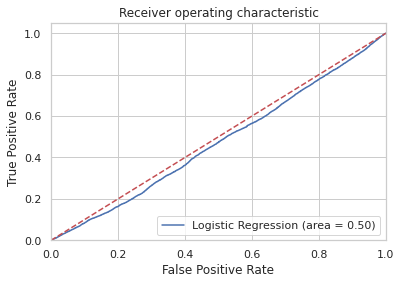

In [ ]:
 #improting all essential libraries for Logistic Regression and Random Forest Method
import statsmodels.api as sm
from sklearn.model_selection import cross_val_score
import statsmodels as statm                                
from sklearn.metrics import make_scorer
from statsmodels.formula.api import ols
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix  

mean_log= np.mean(numericdataX['price'])
classificationData= numericdataX
classificationData.loc[ classificationData['price'] <= mean_log, 'price'] = 0
classificationData.loc[ classificationData['price'] > mean_log, 'price'] = 1

classificationDataY= classificationData['price']
classificationDataX=classificationData.drop(['price'],axis=1)



#creating  training and testing dataset
X_train, X_test, y_train, y_test = train_test_split(classificationDataX, classificationDataY, test_size = 0.2,random_state=0)
classifier= LogisticRegression() 
classifier.fit(X_train,y_train)

#predicting the prices for testing data
y_pred = classifier.predict(X_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(classifier.score(X_test, y_test)))


confusion_matrix = confusion_matrix(y_test, y_pred)
print(confusion_matrix)

#plotting the graph between the actual and predicted values 
print(classification_report(y_test, y_pred))


#ROC curves in logistic regression are used for determining the best cutoff value for predicting whether a new observation is a "failure" (0) or a "success" (1)
def rocAucCurve(classifier):
    logit_roc_auc = roc_auc_score(y_test, classifier.predict(X_test))
    fpr, tpr, thresholds = roc_curve(y_test, classifier.predict_proba(X_test)[:,1])
    plt.figure()
    plt.plot(fpr, tpr, label='Logistic Regression (area = %0.2f)' % logit_roc_auc)
    plt.plot([0, 1], [0, 1],'r--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic')
    plt.legend(loc="lower right")
    plt.savefig('Log_ROC')
    plt.show()


rocAucCurve(classifier)



##**Random Forest Classifier Method**
In this model, we used the minimum_nights, maximum_nights, availabity_365, number_of_reviews, review_scores_rating, review_scores_accuracy, accommodates for the prediction of the price. 

This model estimated the prices after fitting various decision tree classifiers on different sub-tests of the dataset. The final answer is provided after averaging the predictions in order to improve precision and power over-fitting. We were able to get the accuracy of 87% using the random forest model.

In [ ]:
#random forest classifier   
classifierDT = RandomForestClassifier()  
classifierDT.fit(X_train, y_train) 

#predicting the prices based on Random Forest Method 
y_pred = classifierDT.predict(X_test)  

#Performing classification report and observing confusion matrix to see how well model worked
print(confusion_matrix(y_test, y_pred))  
print(classification_report(y_test, y_pred))
rocAucCurve(classifierDT)

TypeError: ignored

##**Findings of predictive analysis**
Random Forest Model is the best model among others as we were able to get the accuracy of 87%. We were able to find out how the 73% of the price can be predicted and the rest of the 27% was using the attributes which was not available in the listing dataset. It is possible that the remaining variance could be using the photos as they are the major support for the increase in the number of visitors at a particular place.